# <center>Análisis Complejidad Electoral 2019: Municipios <center>
## <center>Análisis de Agrupamiento y Construcción Tipología de Complejidad Electoral <center>

<br>

#### <center>INFOTEC-Maestría en Ciencia de Datos e Información <center>
#### <center>Autor: Miguel David Alvarez Hernández (mdalvarezh@gmail.com)<center>

In [1]:
import datetime
now = datetime.datetime.now()
print ("Última versión:")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

Última versión:
2020-09-17 10:38:13


# Setup

In [2]:
import pandas as pd  
import numpy as np
import pandas_profiling
from itertools import combinations 
from dateutil.parser import parse 
import matplotlib as mpl
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import pyplot
from matplotlib.lines import Line2D
import seaborn as sns
import plotly.express as px

In [26]:
#parametros de las gráficas 3d
elev = 50.0
azim = 10.0

#se define diccionario de colores
color_dict = dict({'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey',
                  'G4': 'red',
                  'G5': 'magenta'})

#personalizar leyenda
legend_elements_6 = [Line2D([0], [0], marker='o', markerfacecolor='magenta', color='w', label='G5'),
                   Line2D([0], [0], marker='o', markerfacecolor='red', color='w', label='G4'),
                   Line2D([0], [0], marker='o', markerfacecolor='grey', color='w', label='G3'),
                   Line2D([0], [0], marker='o', markerfacecolor='orange', color='w', label='G2'),
                   Line2D([0], [0], marker='o', markerfacecolor='green', color='w', label='G1'),
                   Line2D([0], [0], marker='o', markerfacecolor='blue', color='w', label='G0')]

legend_elements_5 = [Line2D([0], [0], marker='o', markerfacecolor='red', color='w', label='G4'),
                   Line2D([0], [0], marker='o', markerfacecolor='grey', color='w', label='G3'),
                   Line2D([0], [0], marker='o', markerfacecolor='orange', color='w', label='G2'),
                   Line2D([0], [0], marker='o', markerfacecolor='green', color='w', label='G1'),
                   Line2D([0], [0], marker='o', markerfacecolor='blue', color='w', label='G0')]

legend_elements_4 = [Line2D([0], [0], marker='o', markerfacecolor='grey', color='w', label='G3'),
                   Line2D([0], [0], marker='o', markerfacecolor='orange', color='w', label='G2'),
                   Line2D([0], [0], marker='o', markerfacecolor='green', color='w', label='G1'),
                   Line2D([0], [0], marker='o', markerfacecolor='blue', color='w', label='G0')]

# Importación de datos procesados

In [4]:
#datos procesados
datos = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/1_Procesamiento/Resultados_Datos-procesados_mun2019.csv", encoding='utf-8')

In [5]:
print(datos.dtypes)
datos

EDO                   int64
NOMBRE_ESTADO        object
MUN                   int64
NOMBRE_MUNICIPIO     object
Coef_Var_PE         float64
Coef_Var_LNE        float64
Var_Prop_PE         float64
Var_Prop_LNE        float64
Autocorr_PE         float64
Autocorr_LNE        float64
Razon_LNE_PE        float64
PE                  float64
LNE                 float64
TC_LNE_2019         float64
NUM_SECC_RUR          int64
Area_Km2            float64
Densidad_LNE        float64
dtype: object


,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,Coef_Var_PE,Coef_Var_LNE,Var_Prop_PE,Var_Prop_LNE,Autocorr_PE,Autocorr_LNE,Razon_LNE_PE,PE,LNE,TC_LNE_2019,NUM_SECC_RUR,Area_Km2,Densidad_LNE
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,0.017131,0.015085,0.020041,0.017733,0.965775,0.755939,0.989272,35518.0,34917.0,0.037498,3,9.791576,3566.024547
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,0.005040,0.008345,0.005584,0.008887,0.435676,0.237061,0.991803,7004.0,6914.0,0.000289,4,148.866104,46.444421
2,1,AGUASCALIENTES,9,TEPEZALA,0.006879,0.011777,0.007903,0.011921,0.605737,0.344567,0.990635,15733.0,15545.0,0.005108,6,6.271495,2478.675412
3,1,AGUASCALIENTES,11,EL LLANO,0.008917,0.012239,0.009983,0.014232,0.585621,0.504020,0.991016,15298.0,15067.0,-0.003373,6,10.006312,1505.749552
4,1,AGUASCALIENTES,2,ASIENTOS,0.008083,0.013432,0.009252,0.015397,0.581193,0.374738,0.989080,34722.0,34222.0,0.001874,11,23.049424,1484.722551
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,0.014994,0.019408,0.017748,0.021905,0.987834,0.959378,0.983523,7061.0,6959.0,0.066677,13,190.978234,36.438707
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,0.019415,0.022769,0.022931,0.026072,0.964977,0.984897,0.986450,17610.0,17372.0,0.082705,32,1190.248462,14.595272
2455,32,ZACATECAS,44,TABASCO,0.027363,0.029823,0.032716,0.035416,0.992677,0.993335,0.983221,12689.0,12527.0,0.100307,16,235.714183,53.144872
2456,32,ZACATECAS,9,CHALCHIHUITES,0.016451,0.021097,0.019649,0.024771,0.975279,0.988608,0.982861,8339.0,8222.0,0.075052,10,13.707054,599.837116


In [6]:
#se reordena y eliminan del dataframe las variables que no se usarán
datos_mun = datos.drop(columns=['Coef_Var_PE', 'Var_Prop_PE', 'Autocorr_PE','Area_Km2'])
datos_mun = datos_mun.reindex(columns= ['EDO','NOMBRE_ESTADO','MUN','NOMBRE_MUNICIPIO','NUM_SECC_RUR','LNE','Densidad_LNE','Razon_LNE_PE','TC_LNE_2019','Coef_Var_LNE','Var_Prop_LNE','Autocorr_LNE'])

#verificar si hay valores nulos en datos_mun
datos_mun.isnull().sum()

EDO                 0
NOMBRE_ESTADO       0
MUN                 0
NOMBRE_MUNICIPIO    0
NUM_SECC_RUR        0
LNE                 0
Densidad_LNE        0
Razon_LNE_PE        0
TC_LNE_2019         0
Coef_Var_LNE        0
Var_Prop_LNE        0
Autocorr_LNE        0
dtype: int64

In [7]:
#se eliminan las filas (municipios) con valores vacíos
datos_mun_limpio = datos_mun.dropna()
datos_mun_limpio = datos_mun_limpio.reset_index(drop=True) #para reordenar el índice del nuevo dataframe
datos_mun_limpio.isnull().sum()

EDO                 0
NOMBRE_ESTADO       0
MUN                 0
NOMBRE_MUNICIPIO    0
NUM_SECC_RUR        0
LNE                 0
Densidad_LNE        0
Razon_LNE_PE        0
TC_LNE_2019         0
Coef_Var_LNE        0
Var_Prop_LNE        0
Autocorr_LNE        0
dtype: int64

In [8]:
#se transforman algunos indicadores para analizar escenarios
datos_mun_limpio_tf = datos_mun_limpio.copy()

#np-log de LNE, Densidad
datos_mun_limpio_tf['LNE'] = np.log(datos_mun_limpio_tf['LNE'])
datos_mun_limpio_tf['Densidad_LNE'] = np.log(datos_mun_limpio_tf['Densidad_LNE'])
#datos_mun_limpio_tf['NUM_SECC_RUR'] = np.log(datos_mun_limpio_tf['NUM_SECC_RUR']+1)

In [9]:
#se separan los indicadores de los metadatos 

#metadatos
metadatos = datos_mun_limpio[['EDO', 'NOMBRE_ESTADO', 'MUN', 'NOMBRE_MUNICIPIO']]

#8 indicadores (features)
datos_mun_limpio_f = datos_mun_limpio[['NUM_SECC_RUR','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE','Autocorr_LNE']]

#8 indicadores con transformación log (features)
datos_mun_limpio_f_tf = datos_mun_limpio_tf[['NUM_SECC_RUR','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE','Autocorr_LNE']]

#7 indicadores(features)
datos_mun_limpio_f_ind7 = datos_mun_limpio[['NUM_SECC_RUR','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE']]

#7 indicadores con transformación log (features)
datos_mun_limpio_f_tf_ind7 = datos_mun_limpio_tf[['NUM_SECC_RUR','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE']]

# Resultados de los escenarios PCA

In [10]:
#escenario con 7 indicadores (sin Coef_Var_Prop)
df_pca_results_ind7 = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/2_Exploratorio-PCA/Resultados_Mun_PCA_ind7.csv", dtype={'EDO':int,'MUN':int})

#formamos un np-array con las columnas_pca para la sección de métodos de agrupamiento
columnas_7pca = ['CP1', 'CP2', 'CP3','CP4', 'CP5', 'CP6','CP7']
x_pca = df_pca_results_ind7.loc[:, columnas_7pca].values

print(x_pca.shape)

(2458, 7)


In [11]:
#escenario con 7 indicadores (sin Coef_Var_Prop) con transformacion log
df_pca_results_ind7_tf = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/2_Exploratorio-PCA/Resultados_Mun_PCA_ind7_tf.csv", dtype={'EDO':int,'MUN':int})

#formamos un np-array con las columnas_pca para la sección de métodos de agrupamiento
columnas_7pca = ['CP1', 'CP2', 'CP3','CP4', 'CP5', 'CP6','CP7']
x1_pca = df_pca_results_ind7_tf.loc[:, columnas_7pca].values

print(x1_pca.shape)

(2458, 7)


In [12]:
#escenario con 8 indicadores 
df_pca_results_ind8 = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/2_Exploratorio-PCA/Resultados_Mun_PCA_ind8.csv", dtype={'EDO':int,'MUN':int})

#formamos un np-array con las columnas_pca para la sección de métodos de agrupamiento
columnas_8pca =  ['CP1', 'CP2', 'CP3','CP4', 'CP5', 'CP6','CP7', 'CP8']
x2_pca = df_pca_results_ind8.loc[:, columnas_8pca].values

print(x2_pca.shape)

(2458, 8)


In [13]:
#escenario con 8 indicadores con transformación log (solo en LNE y Densidad)
df_pca_results_ind8_tf = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Mun/2_Exploratorio-PCA/Resultados_Mun_PCA_ind8_tf.csv", dtype={'EDO':int,'MUN':int})

#formamos un np-array con las columnas_pca para la sección de métodos de agrupamiento
columnas_8pca =  ['CP1', 'CP2', 'CP3','CP4', 'CP5', 'CP6','CP7', 'CP8']
x3_pca = df_pca_results_ind8_tf.loc[:, columnas_8pca].values

print(x3_pca.shape)

(2458, 8)


<br>

# Agrupamiento y construcción de la Tipología de Complejidad

## Análisis de silueta y configuración óptima de grupos (7 indicadores)
Cálculo de los silhouette_scores para diferentes números de clusters en Kmeans

For n_clusters = 2 The average silhouette_score is : 0.3223029062420627
For n_clusters = 3 The average silhouette_score is : 0.34579288002212155
For n_clusters = 4 The average silhouette_score is : 0.28122309989970967
For n_clusters = 5 The average silhouette_score is : 0.2979982176919014
For n_clusters = 6 The average silhouette_score is : 0.24431713756363227
For n_clusters = 7 The average silhouette_score is : 0.24884584789422254


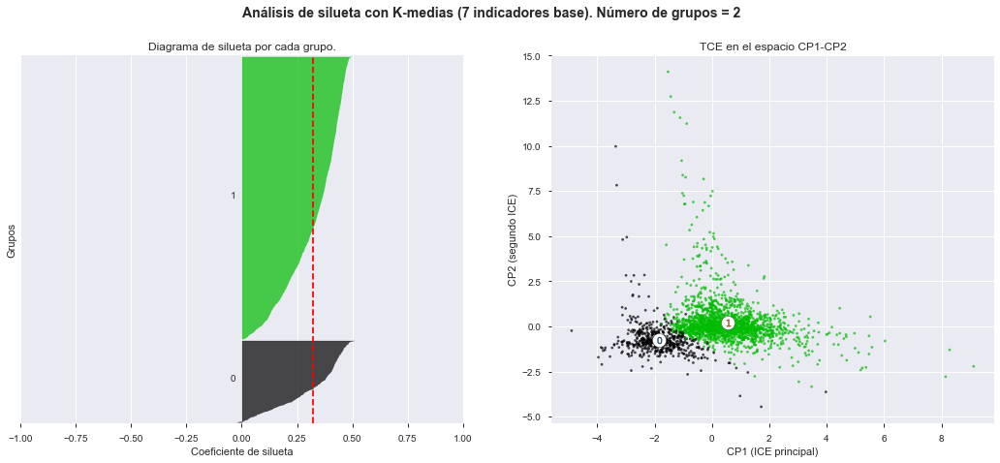

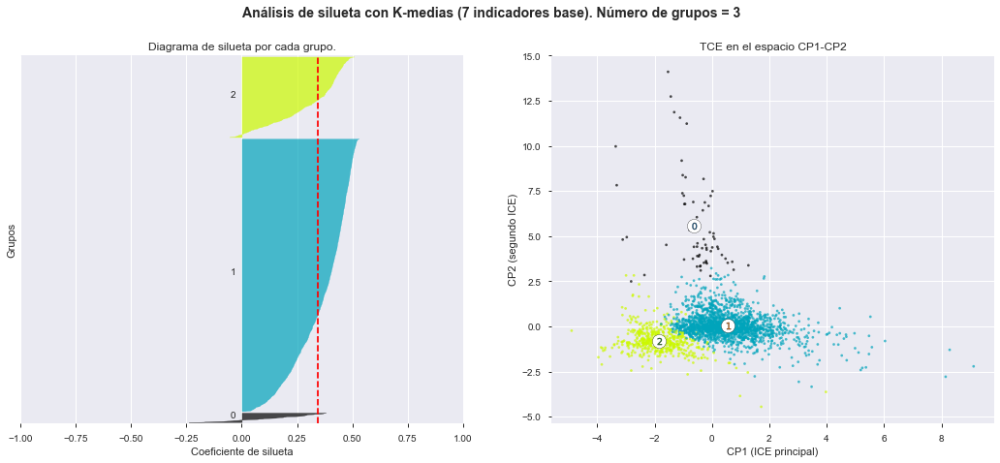

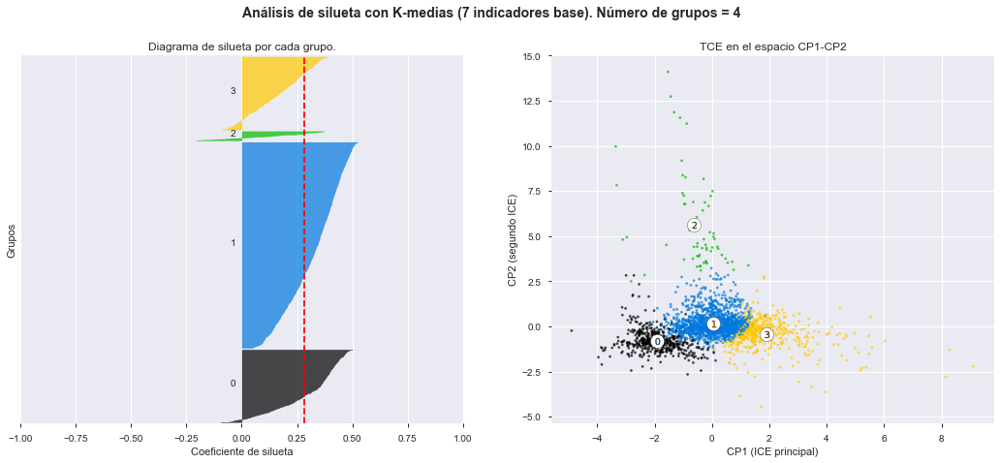

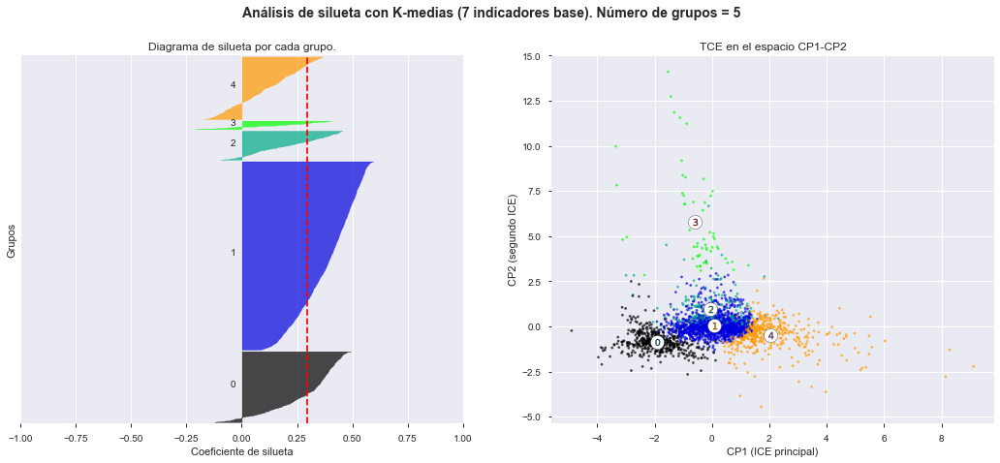

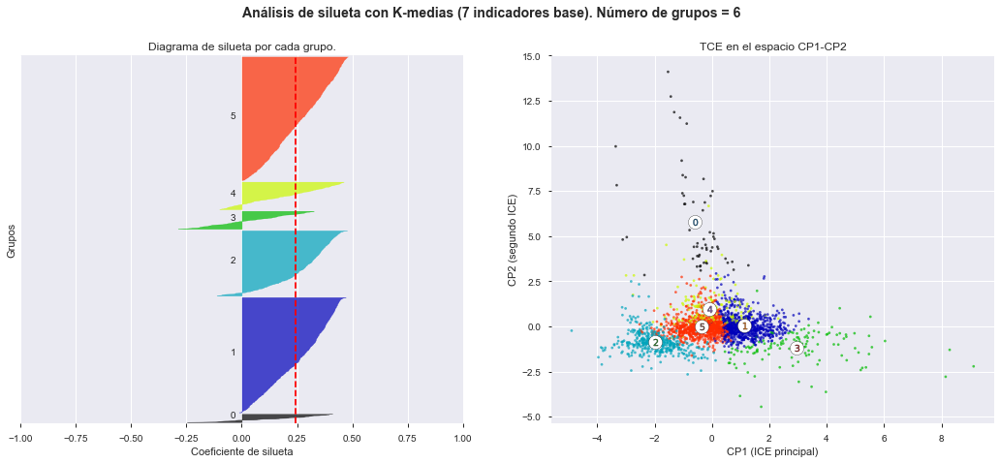

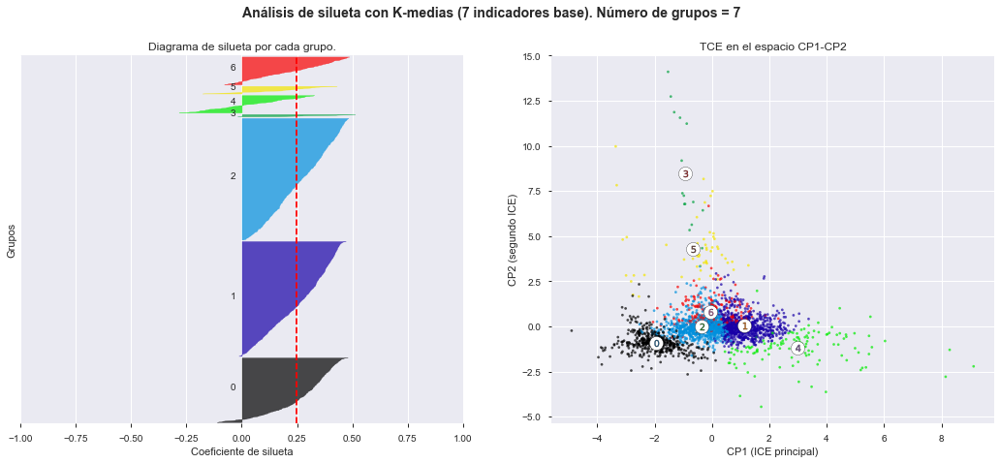

In [14]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

#Datos en el espacio de las componentes principales
X=x_pca

#numero de clusters/grupos que serán analizados
range_n_clusters = [2, 3, 4, 5,6,7]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 0 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Diagrama de silueta por cada grupo.")
    ax1.set_xlabel("Coeficiente de silueta")
    ax1.set_ylabel("Grupos")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("TCE en el espacio CP1-CP2")
    ax2.set_xlabel("CP1 (ICE principal)")
    ax2.set_ylabel("CP2 (segundo ICE)")

    plt.suptitle(("Análisis de silueta con K-medias (7 indicadores base). "
                  "Número de grupos = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    plt.savefig('Pyplot_silhouette_score_ind7_Kmeans_'+str(n_clusters)+'.png',dpi=600)

**Se elige la configuración de 5 clusters** (es la tercera configuración con el mayor valor promedio de silueta, pero presenta un agrupamiento adecuado en la proyección bidimensional)

In [15]:
#se obtienen las etiquetas predichas por K-medias para la configuración con el mayor
#valor promedio del silhouete score (n=5)
num_clusters_ind7 = 5
clusterer_K = KMeans(n_clusters=num_clusters_ind7, random_state=0)
clusterer_K_labels = clusterer_K.fit_predict(X)

#se obtienen las etiquetas predichas por Kmeans
y_pred_kmeans = clusterer_K_labels
#se guarda el nparray en un dataframe
y_pred_kmeans = pd.DataFrame(y_pred_kmeans, columns=['TCE_municipal'])

#se transforman las etiquetas numéricas a str
etiquetas_grupos = {0:'G0', 1:'G1', 2:'G2', 3:'G3', 4:'G4', 5:'G5'}
y_pred_kmeans['TCE_municipal']=y_pred_kmeans['TCE_municipal'].apply(lambda x: etiquetas_grupos[x])

#concatenamos los resultados de PCA con las etiquetas de Kmeans
df_pca_results_ind7_kmeans = pd.concat([df_pca_results_ind7, y_pred_kmeans], axis = 1)

#se guardan los resultados en un csv
df_pca_results_ind7_kmeans.to_csv(r'Resultados_Mun_PCA_Kmeans_ind7.csv', index = None)

df_pca_results_ind7_kmeans

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-1.061899,0.788043,-0.837586,-0.614461,-0.088128,-0.782747,-0.238578,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.242619,-1.163180,-0.391435,0.193575,0.880911,0.128676,-1.012632,G0
2,1,AGUASCALIENTES,9,TEPEZALA,-2.714649,-0.207140,-0.939179,0.184211,0.615393,-0.770295,-0.744057,G0
3,1,AGUASCALIENTES,11,EL LLANO,-2.489077,-0.324405,-0.411126,-0.029804,0.468563,-0.389211,-0.141379,G0
4,1,AGUASCALIENTES,2,ASIENTOS,-2.499466,-0.395191,-0.509621,0.718468,0.620966,-0.484175,-0.511286,G0
...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,0.548172,-0.308683,0.679952,0.209243,-0.452260,0.088731,-0.062292,G1
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,0.875699,0.306366,1.949664,0.996421,0.061302,-0.572234,-0.267121,G2
2455,32,ZACATECAS,44,TABASCO,1.864008,-0.162682,0.715202,0.470561,0.292022,-0.127472,-0.194333,G4
2456,32,ZACATECAS,9,CHALCHIHUITES,0.886651,-0.151959,0.337662,0.033250,-0.481215,-0.003173,-0.078652,G1


## Análisis de silueta y configuración óptima de grupos (7 indicadores con transformación log)
Cálculo de los silhouette_scores para diferentes números de clusters en Kmeans

For n_clusters = 2 The average silhouette_score is : 0.2697086044646516
For n_clusters = 3 The average silhouette_score is : 0.2064941273958568
For n_clusters = 4 The average silhouette_score is : 0.2388640726285676
For n_clusters = 5 The average silhouette_score is : 0.20955323216765342
For n_clusters = 6 The average silhouette_score is : 0.1996011922843045
For n_clusters = 7 The average silhouette_score is : 0.1979145162039043


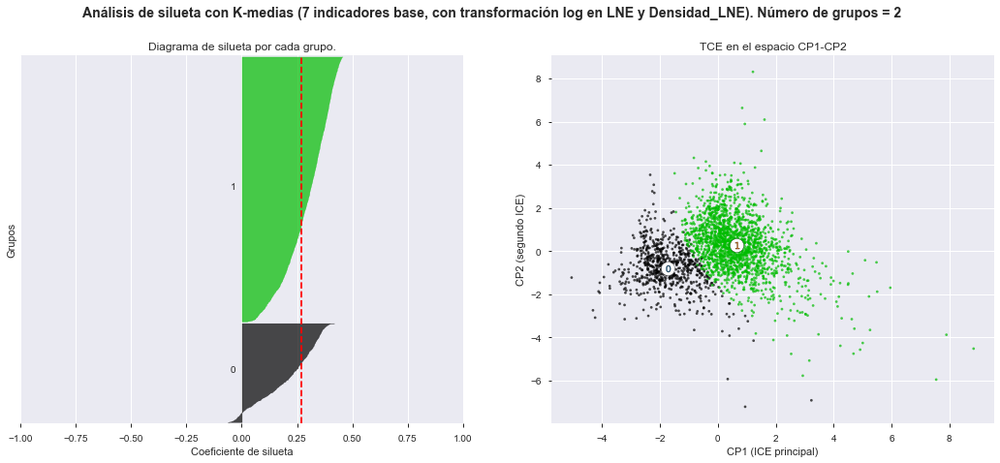

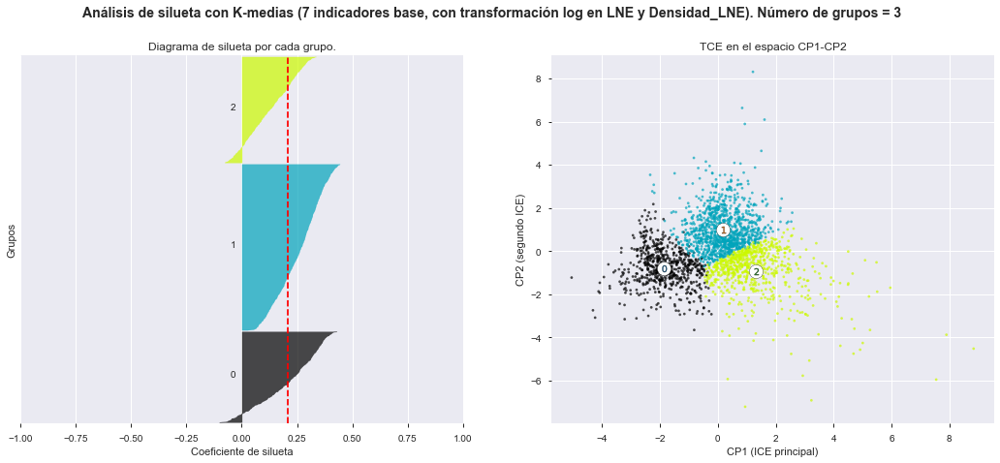

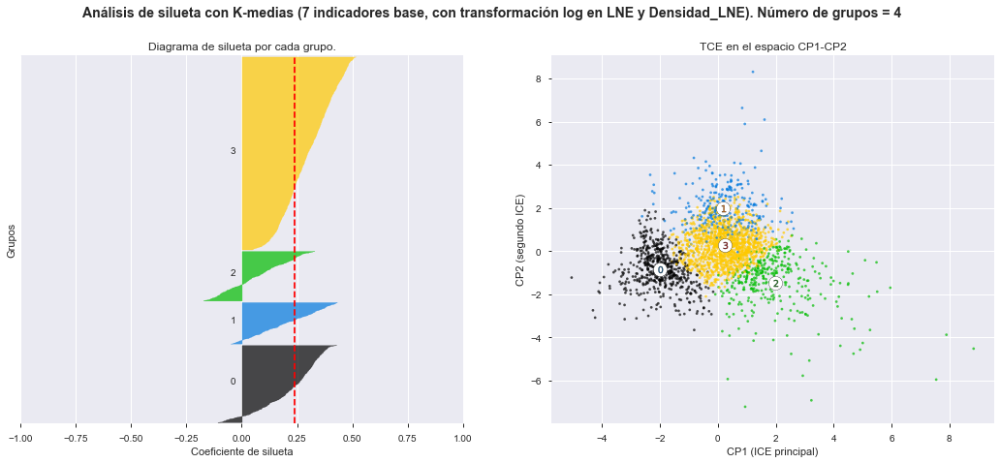

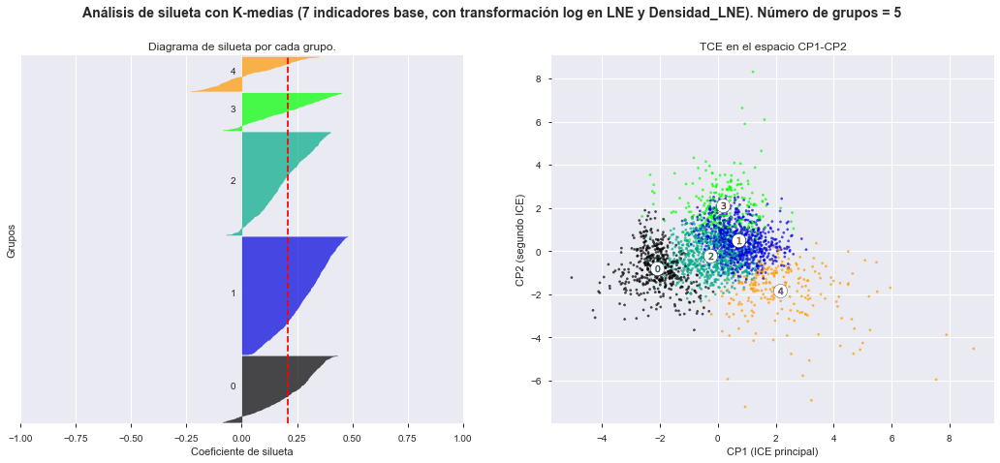

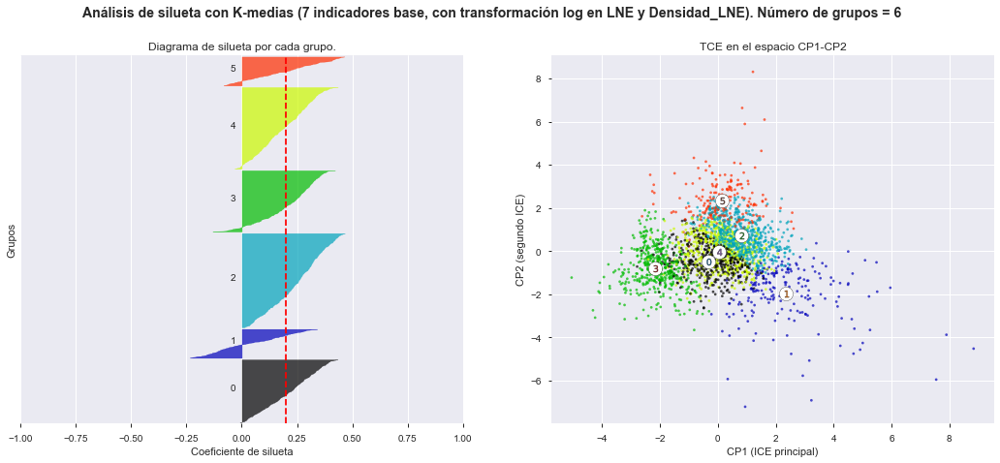

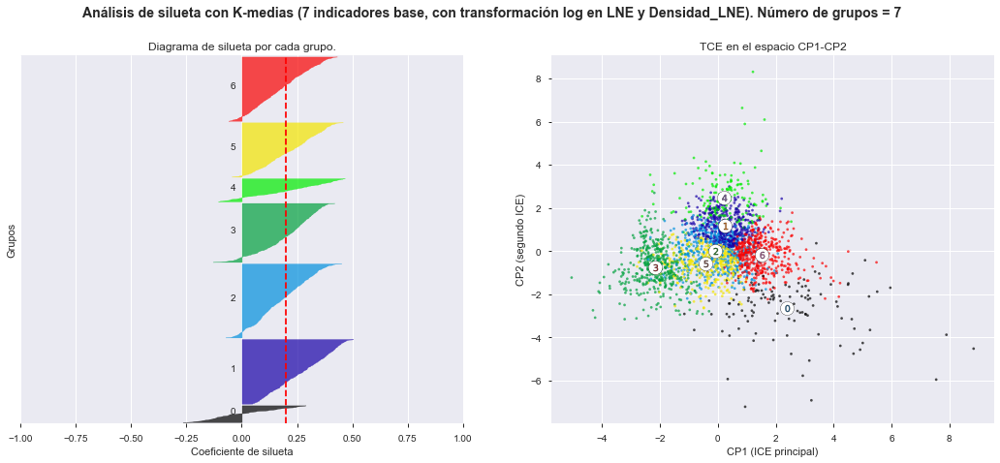

In [16]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

#Datos en el espacio de las componentes principales
X=x1_pca

#numero de clusters/grupos que serán analizados
range_n_clusters = [2, 3, 4, 5, 6, 7]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 0 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Diagrama de silueta por cada grupo.")
    ax1.set_xlabel("Coeficiente de silueta")
    ax1.set_ylabel("Grupos")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("TCE en el espacio CP1-CP2")
    ax2.set_xlabel("CP1 (ICE principal)")
    ax2.set_ylabel("CP2 (segundo ICE)")

    plt.suptitle(("Análisis de silueta con K-medias (7 indicadores base, con transformación log en LNE y Densidad_LNE). "
                  "Número de grupos = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    plt.savefig('Pyplot_silhouette_score_ind7_tf_Kmeans_'+str(n_clusters)+'.png',dpi=600)

**Se elige la configuración de 4 clusters** (segunda configuración con el mayor valor promedio de silueta, pero con un mejor distribución en la proyección bidimensional).

In [17]:
#se obtienen las etiquetas predichas por K-medias para la configuración con el mejor
#valor promedio del silhouete score, o con la mejor distribucion de los silhouetes (n=4)
num_clusters_ind7_tf = 4
clusterer_K = KMeans(n_clusters=num_clusters_ind7_tf, random_state=0)
clusterer_K_labels = clusterer_K.fit_predict(X)

#se obtienen las etiquetas predichas por Kmeans
y_pred_kmeans = clusterer_K_labels
#se guarda el nparray en un dataframe
y_pred_kmeans = pd.DataFrame(y_pred_kmeans, columns=['TCE_municipal'])

#se transforman las etiquetas numéricas a str
etiquetas_grupos = {0:'G0', 1:'G1', 2:'G2', 3:'G3', 4:'G4', 5:'G5'}
y_pred_kmeans['TCE_municipal']=y_pred_kmeans['TCE_municipal'].apply(lambda x: etiquetas_grupos[x])

#concatenamos los resultados de PCA con las etiquetas de Kmeans
df_pca_results_ind7_tf_kmeans = pd.concat([df_pca_results_ind7_tf, y_pred_kmeans], axis = 1)

#se guardan los resultados en un csv
df_pca_results_ind7_tf_kmeans.to_csv(r'Resultados_Mun_PCA_Kmeans_ind7_tf.csv', index = None)

df_pca_results_ind7_tf_kmeans

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-0.995331,0.745533,-1.389633,0.434649,0.105639,-0.259502,-0.196240,G3
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.318903,-0.619987,0.723898,0.193995,-0.969311,-0.651817,-1.034857,G0
2,1,AGUASCALIENTES,9,TEPEZALA,-2.757468,0.081456,-0.908153,1.115722,-0.558179,-0.004696,-0.705979,G0
3,1,AGUASCALIENTES,11,EL LLANO,-2.523745,0.260810,-0.738536,0.676101,-0.383889,-0.048412,-0.126217,G0
4,1,AGUASCALIENTES,2,ASIENTOS,-2.490247,0.453746,-0.450692,1.507864,-0.496284,-0.207700,-0.497406,G0
...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,0.566375,-0.038837,1.137560,-0.402981,0.304617,0.000411,-0.066702,G3
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,1.080969,1.300230,2.208190,-0.057168,-0.342807,0.496959,-0.236424,G1
2455,32,ZACATECAS,44,TABASCO,1.911600,0.178614,0.950089,0.065079,-0.393423,0.058249,-0.192537,G2
2456,32,ZACATECAS,9,CHALCHIHUITES,0.851114,0.072100,-0.200368,0.061119,0.545074,0.389442,-0.072882,G3


<br>

## Análisis de silueta y configuración óptima de grupos (8 indicadores)
Cálculo de los silhouette_scores para diferentes números de clusters en Kmeans

For n_clusters = 2 The average silhouette_score is : 0.23462927134833064
For n_clusters = 3 The average silhouette_score is : 0.2554947663340664
For n_clusters = 4 The average silhouette_score is : 0.272812874936938
For n_clusters = 5 The average silhouette_score is : 0.27820472063664164
For n_clusters = 6 The average silhouette_score is : 0.26508285823698857
For n_clusters = 7 The average silhouette_score is : 0.27097947983229775


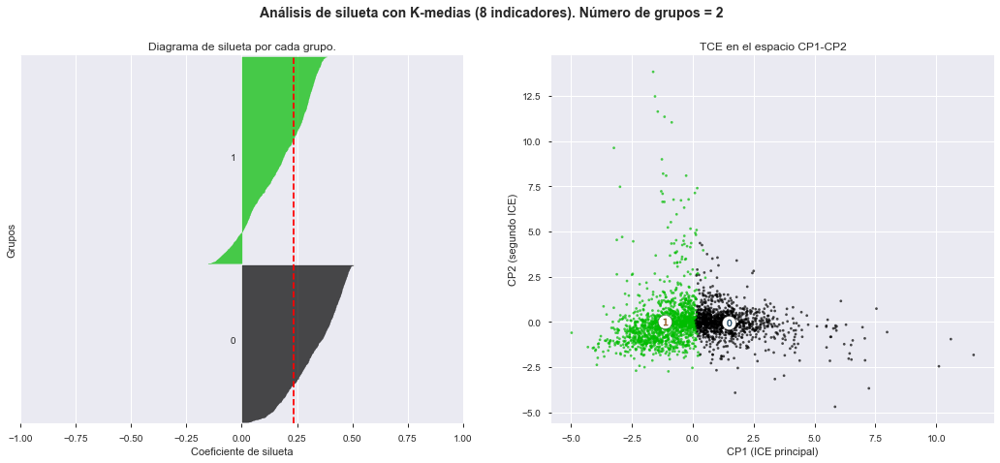

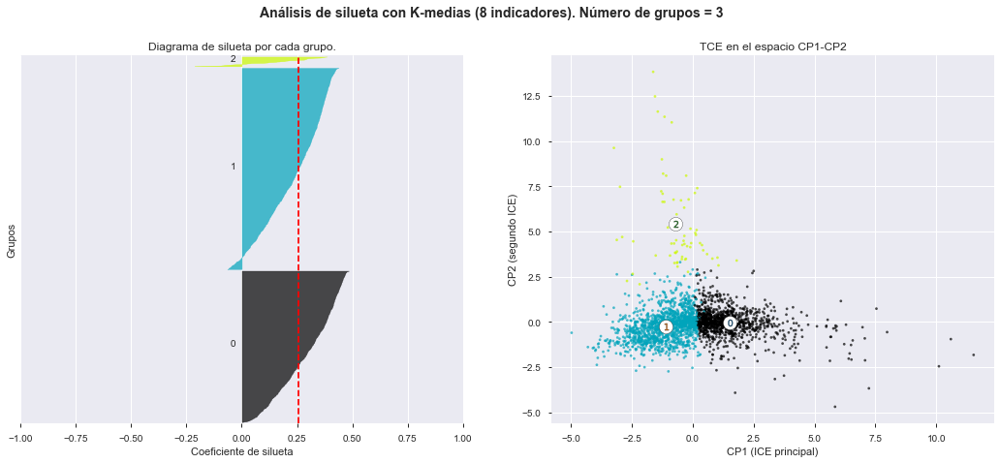

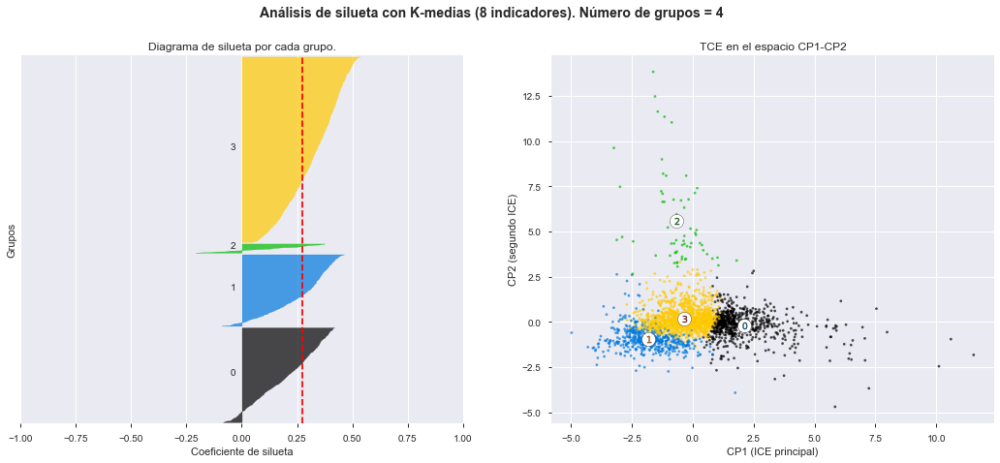

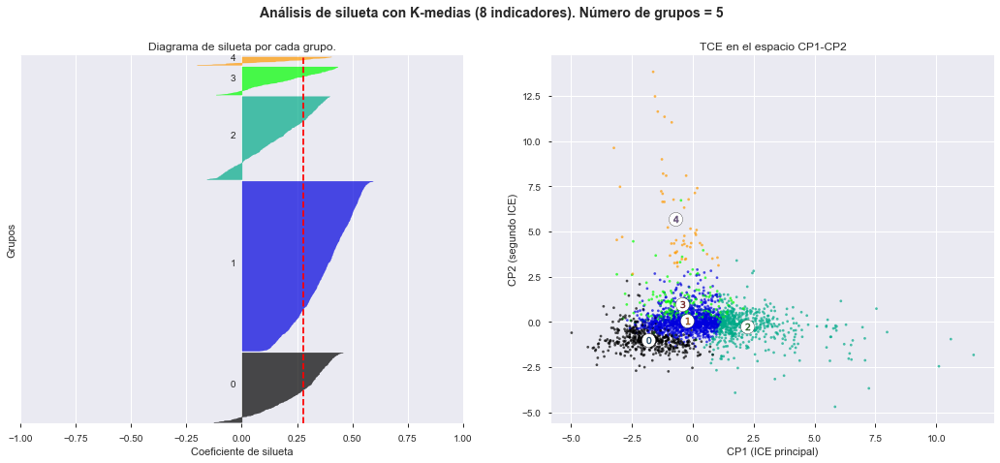

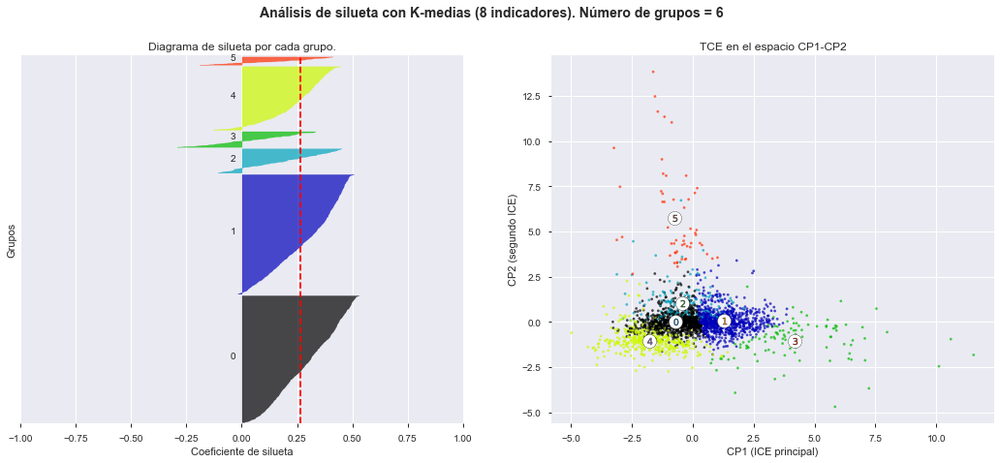

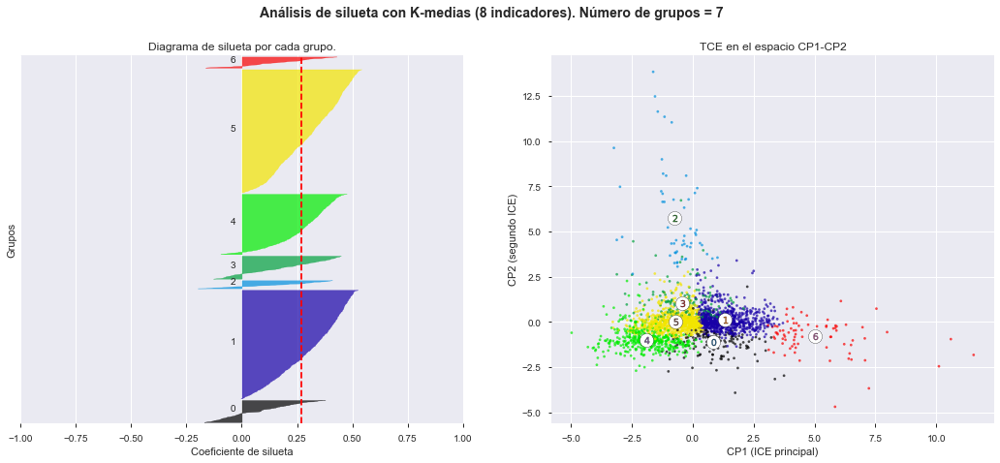

In [18]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

#Datos en el espacio de las componentes principales
X=x2_pca

#numero de clusters/grupos que serán analizados
range_n_clusters = [2, 3, 4, 5, 6, 7]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 0 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Diagrama de silueta por cada grupo.")
    ax1.set_xlabel("Coeficiente de silueta")
    ax1.set_ylabel("Grupos")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("TCE en el espacio CP1-CP2")
    ax2.set_xlabel("CP1 (ICE principal)")
    ax2.set_ylabel("CP2 (segundo ICE)")

    plt.suptitle(("Análisis de silueta con K-medias (8 indicadores). "
                  "Número de grupos = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    plt.savefig('Pyplot_silhouette_score_ind8_Kmeans_'+str(n_clusters)+'.png',dpi=600)

**Se elige la configuración de 5 clusters** (configuración con el mayor valor promedio de silueta)

In [19]:
#se obtienen las etiquetas predichas por K-medias para la configuración con el mayor
#valor promedio del silhouete score, o la mejor distribución de silhouetes (n=5)
num_clusters_ind8 = 5
clusterer_K = KMeans(n_clusters=num_clusters_ind8, random_state=0)
clusterer_K_labels = clusterer_K.fit_predict(X)

#se obtienen las etiquetas predichas por Kmeans
y_pred_kmeans = clusterer_K_labels
#se guarda el nparray en un dataframe
y_pred_kmeans = pd.DataFrame(y_pred_kmeans, columns=['TCE_municipal'])

#se transforman las etiquetas numéricas a str (adecuacion para preservar color de anteriores graficas)
etiquetas_grupos = {0:'G0', 1:'G1', 2:'G2', 3:'G3', 4:'G4', 5:'G5'}
y_pred_kmeans['TCE_municipal']=y_pred_kmeans['TCE_municipal'].apply(lambda x: etiquetas_grupos[x])

#concatenamos los resultados de PCA con las etiquetas de Kmeans
df_pca_results_ind8_kmeans = pd.concat([df_pca_results_ind8, y_pred_kmeans], axis = 1)

#se guardan los resultados en un csv
df_pca_results_ind8_kmeans.to_csv(r'Resultados_Mun_PCA_Kmeans_ind8.csv', index = None)

df_pca_results_ind8_kmeans

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-1.212730,0.714345,0.923540,-0.603382,-0.084640,-0.782450,-0.261916,-0.003056,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.406688,-1.362798,0.754667,0.415810,-0.885600,0.272844,-1.093298,0.029088,G0
2,1,AGUASCALIENTES,9,TEPEZALA,-2.795431,-0.391567,1.266848,0.337623,-0.693461,-0.657287,-0.864759,0.099806,G0
3,1,AGUASCALIENTES,11,EL LLANO,-2.524197,-0.487015,0.724376,0.172457,-0.717782,-0.340382,-0.187773,-0.019983,G0
4,1,AGUASCALIENTES,2,ASIENTOS,-2.419575,-0.569647,0.875752,0.915294,-0.718031,-0.391693,-0.592203,-0.023749,G0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,0.293567,-0.246173,-0.802060,0.124052,0.581356,0.047280,-0.025936,0.065240,G1
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,0.752369,0.392485,-1.955040,1.087186,-0.002043,-0.540422,-0.324093,0.042029,G3
2455,32,ZACATECAS,44,TABASCO,2.209573,-0.054915,-0.842182,0.460205,-0.155634,-0.075444,-0.244536,-0.061517,G2
2456,32,ZACATECAS,9,CHALCHIHUITES,0.749358,-0.079880,-0.495159,-0.084159,0.593947,-0.049198,-0.034575,-0.001863,G1


<br>

## Análisis de silueta y configuración óptima de grupos (8 indicadores con transformación log en LNE y Densidad_LNE)
Cálculo de los silhouette_scores para diferentes números de clusters en Kmeans

For n_clusters = 2 The average silhouette_score is : 0.20294071190092197
For n_clusters = 3 The average silhouette_score is : 0.20988078268805957
For n_clusters = 4 The average silhouette_score is : 0.21687201983414728
For n_clusters = 5 The average silhouette_score is : 0.20352946722750853
For n_clusters = 6 The average silhouette_score is : 0.18728012284568613
For n_clusters = 7 The average silhouette_score is : 0.19105714308983474


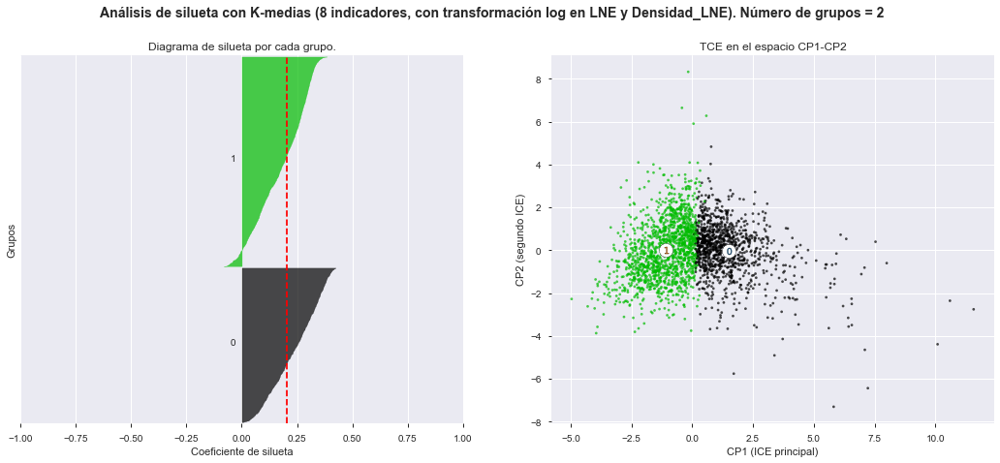

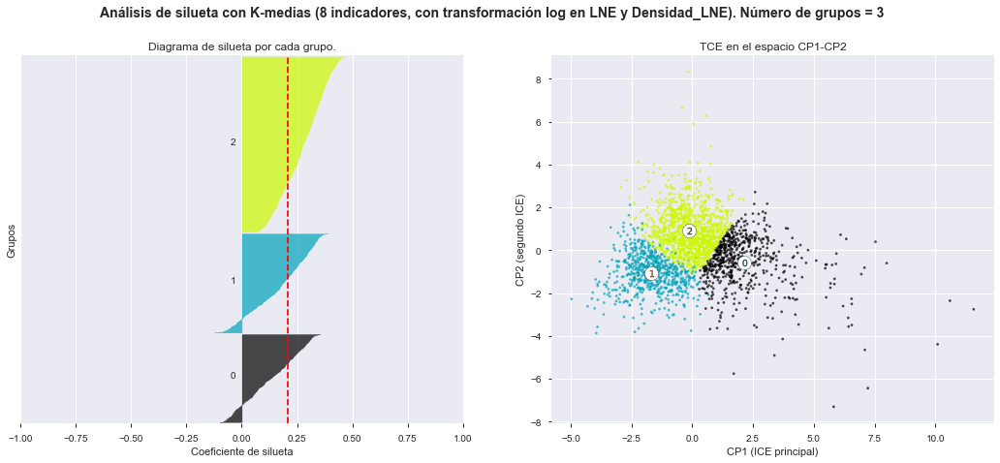

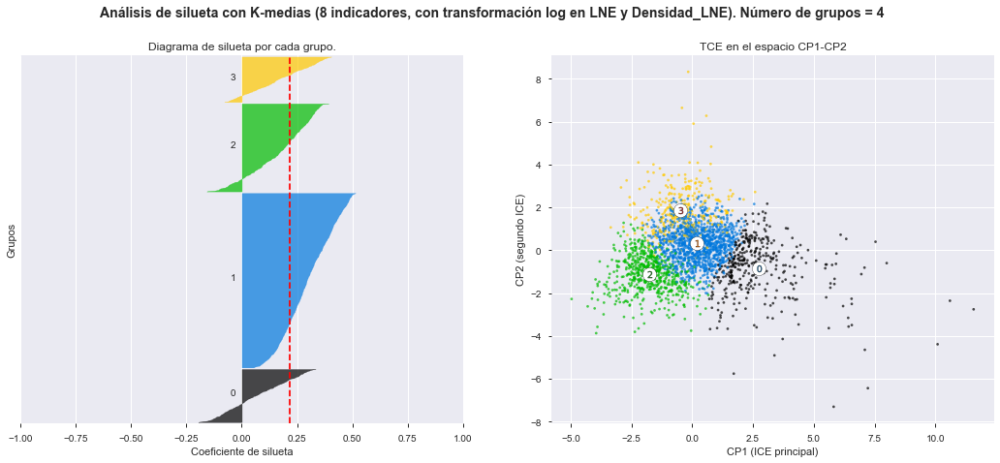

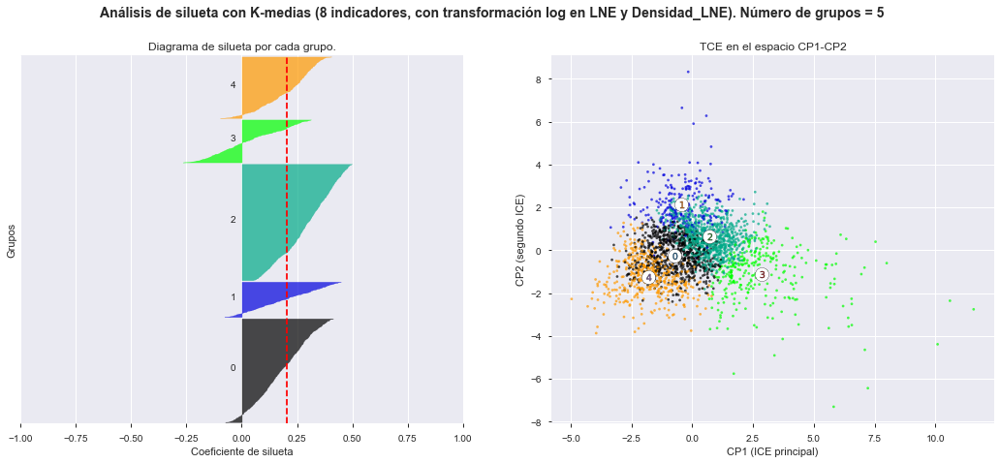

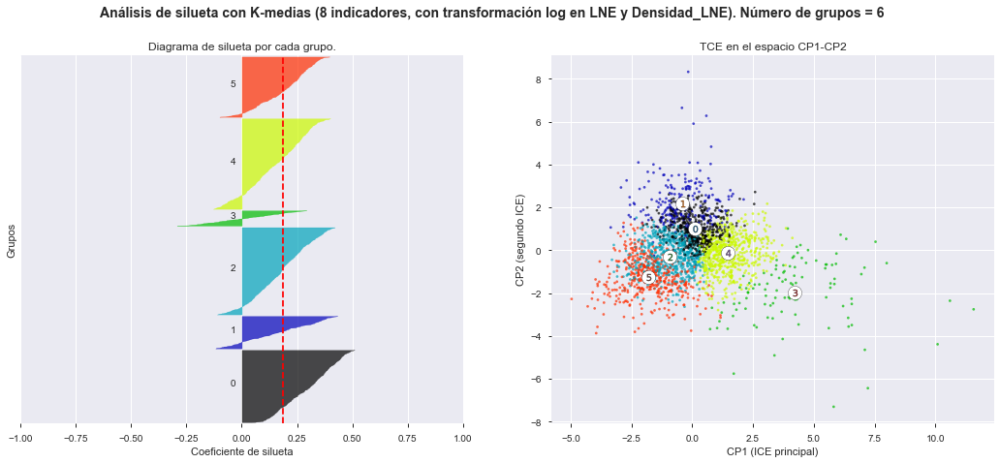

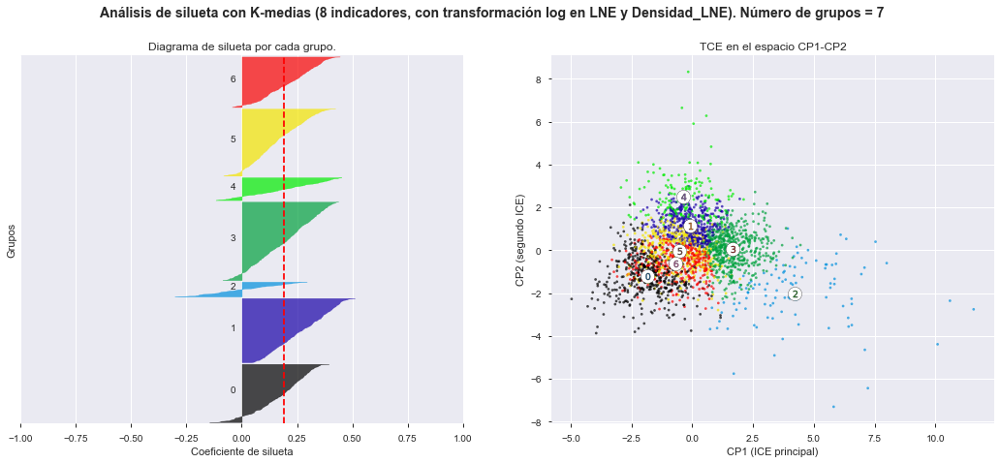

In [20]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

#Datos en el espacio de las componentes principales
X=x3_pca

#numero de clusters/grupos que serán analizados
range_n_clusters = [2, 3, 4, 5, 6, 7]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 0 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=0)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Diagrama de silueta por cada grupo.")
    ax1.set_xlabel("Coeficiente de silueta")
    ax1.set_ylabel("Grupos")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("TCE en el espacio CP1-CP2")
    ax2.set_xlabel("CP1 (ICE principal)")
    ax2.set_ylabel("CP2 (segundo ICE)")

    plt.suptitle(("Análisis de silueta con K-medias (8 indicadores, con transformación log en LNE y Densidad_LNE). "
                  "Número de grupos = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    plt.savefig('Pyplot_silhouette_score_ind8_tf_Kmeans_'+str(n_clusters)+'.png',dpi=600)

**Se elige la configuración de 4 clusters** (configuración con el mayor valor promedio de silueta)

In [21]:
#se obtienen las etiquetas predichas por K-medias para la configuración con el mayor
#valor promedio del silhouete score (n=4)
num_clusters_ind8_tf = 4
clusterer_K = KMeans(n_clusters=num_clusters_ind8_tf, random_state=0)
clusterer_K_labels = clusterer_K.fit_predict(X)

#se obtienen las etiquetas predichas por Kmeans
y_pred_kmeans = clusterer_K_labels
#se guarda el nparray en un dataframe
y_pred_kmeans = pd.DataFrame(y_pred_kmeans, columns=['TCE_municipal'])

#se transforman las etiquetas numéricas a str (adecuacion para preservar color de anteriores graficas)
etiquetas_grupos = {0:'G0', 1:'G1', 2:'G2', 3:'G3', 4:'G4', 5:'G5'}
y_pred_kmeans['TCE_municipal']=y_pred_kmeans['TCE_municipal'].apply(lambda x: etiquetas_grupos[x])

#concatenamos los resultados de PCA con las etiquetas de Kmeans
df_pca_results_ind8_tf_kmeans = pd.concat([df_pca_results_ind8_tf, y_pred_kmeans], axis = 1)

#se guardan los resultados en un csv
df_pca_results_ind8_tf_kmeans.to_csv(r'Resultados_Mun_PCA_Kmeans_ind8_tf.csv', index = None)

df_pca_results_ind8_tf_kmeans

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-1.214070,0.513032,-1.450945,0.431519,0.182643,-0.259314,-0.187243,0.010094,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.422301,-1.284015,0.577059,0.648052,-0.969611,-0.638014,-1.147983,0.037785,G2
2,1,AGUASCALIENTES,9,TEPEZALA,-2.820073,-0.517094,-1.072523,1.362320,-0.340752,0.004996,-0.799488,0.107345,G2
3,1,AGUASCALIENTES,11,EL LLANO,-2.557359,-0.295472,-0.890254,0.975709,-0.418065,-0.044813,-0.157649,-0.013624,G2
4,1,AGUASCALIENTES,2,ASIENTOS,-2.449705,-0.118811,-0.643405,1.811638,-0.307746,-0.200200,-0.563693,-0.009320,G2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,0.294566,0.126657,1.201204,-0.512943,0.306917,-0.001819,-0.039371,0.061847,G1
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,0.770249,1.514170,2.214195,0.063605,-0.312969,0.501606,-0.285044,0.033742,G3
2455,32,ZACATECAS,44,TABASCO,2.207745,0.543961,0.993419,0.054510,-0.291653,0.063391,-0.248878,-0.062676,G0
2456,32,ZACATECAS,9,CHALCHIHUITES,0.723186,0.265904,-0.141626,-0.185856,0.667093,0.385281,-0.014308,-0.006761,G1


<br>

# Escenario 1: TCE con 5 clusters y 7 indicadores

Se utiliza la última iteración guardada de K-medias para asegurar la reproducibilidad de los resultados (recordando que K-medias es un algoritmo estocástico; y por lo tanto, en cada iteración hay variaciones en la asignación de grupos).

In [22]:
#df_pca_results_ind7_kmeans = pd.read_csv("Resultados_Mun_PCA_Kmeans_ind7.csv", dtype={'EDO':int,'MUN':int,'CP1':float, 'CP2':float, 'CP3':float})
df_pca_results_ind7_kmeans.head()

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-1.061899,0.788043,-0.837586,-0.614461,-0.088128,-0.782747,-0.238578,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.242619,-1.163180,-0.391435,0.193575,0.880911,0.128676,-1.012632,G0
2,1,AGUASCALIENTES,9,TEPEZALA,-2.714649,-0.207140,-0.939179,0.184211,0.615393,-0.770295,-0.744057,G0
3,1,AGUASCALIENTES,11,EL LLANO,-2.489077,-0.324405,-0.411126,-0.029804,0.468563,-0.389211,-0.141379,G0
4,1,AGUASCALIENTES,2,ASIENTOS,-2.499466,-0.395191,-0.509621,0.718468,0.620966,-0.484175,-0.511286,G0


Gráfica en el espacio CP1, CP2

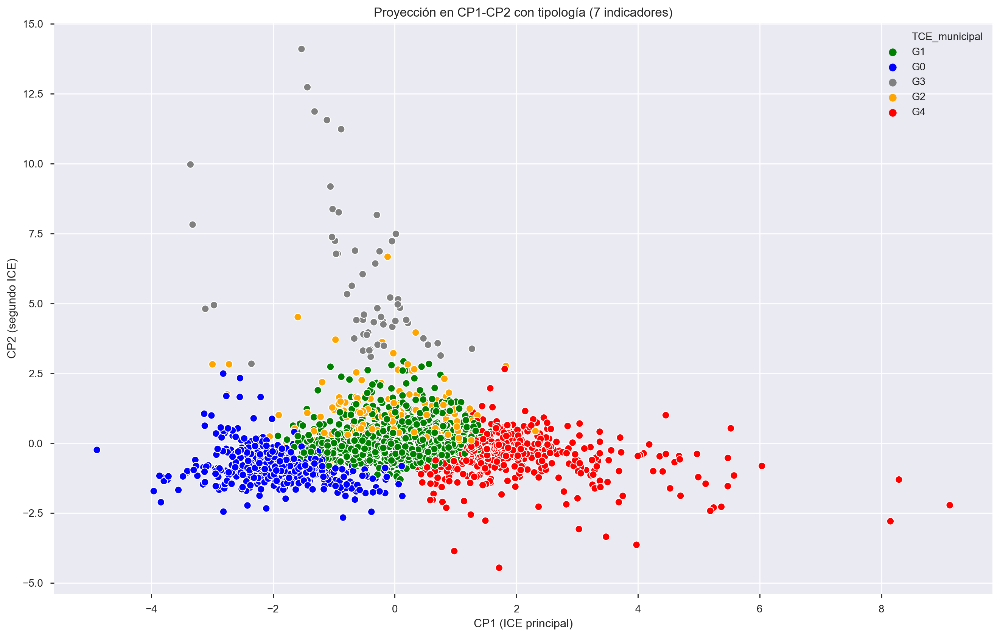

In [23]:
#Scatter plot (seaborn) CP1 vs CP2 (con clustering k-means)

plt.figure(figsize=(16, 10), dpi= 200, facecolor='w', edgecolor='k')
sns.scatterplot(x="CP1", y="CP2", 
                data=df_pca_results_ind7_kmeans, 
                hue="TCE_municipal",
                palette=color_dict)
# Set x-axis label
plt.xlabel('CP1 (ICE principal)')
# Set y-axis label
plt.ylabel('CP2 (segundo ICE)')
plt.title('Proyección en CP1-CP2 con tipología (7 indicadores)')

plt.savefig('Pyplot_PCA_Kmeans_ind7.png',dpi=600)

Gráfica en el espacio CP1, CP2, CP3

In [28]:
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.lines import Line2D

#para definir los colores
colores = df_pca_results_ind7_kmeans['TCE_municipal'].apply(lambda x: color_dict[x])

#figura
fig = pyplot.figure(figsize=(16, 10), dpi=600, facecolor='w', edgecolor='k')
ax = Axes3D(fig)
ax.scatter(df_pca_results_ind7_kmeans['CP1'], df_pca_results_ind7_kmeans['CP2'], df_pca_results_ind7_kmeans['CP3'], c=colores,s=15)
# ax.set_xlim3d(-10, 40)
ax.set_ylim3d(-7.5,7.5)
ax.set_zlim3d(-2,8)
ax.set_xlabel('CP1 (ICE principal)')
ax.set_ylabel('CP2 (segundo ICE)')
ax.set_zlabel('CP3 (tercer ICE)')
ax.view_init(elev, azim)
ax.legend(title='TCE_municipal', handles=legend_elements_5, loc='center right',fontsize='x-large')
ax.set_title('Proyección en CP1-CP2-CP3 con tipología (7 indicadores)')

plt.savefig('Pyplot_PCA_3d_Kmeans_ind7.png',dpi=600)
pyplot.show()

Gráfica 3d animada

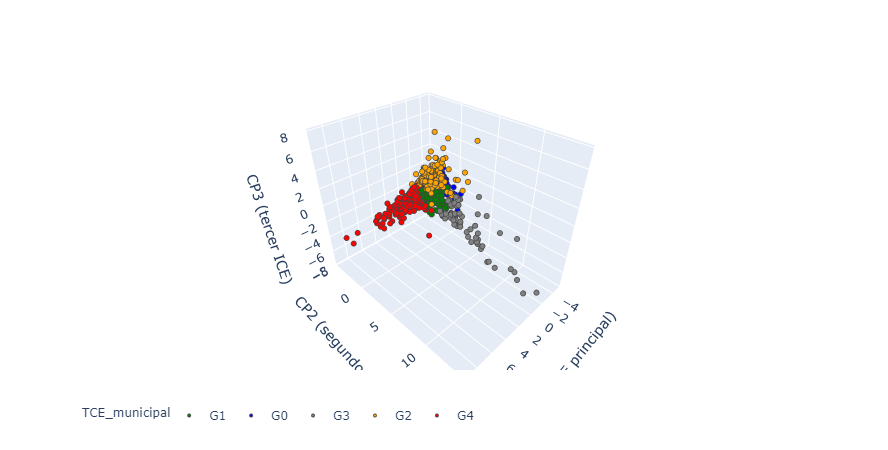

In [25]:
#3-d plot con plotly
fig = px.scatter_3d(df_pca_results_ind7_kmeans, x='CP1', y='CP2', z='CP3',
              color='TCE_municipal',
                    color_discrete_map={
                  'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey',
                  'G4': 'red',
                  'G5': 'magenta'})
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                 legend_orientation="h")
fig.show()

<br>

# Escenario 2: TCE con 4 clusters y 7 indicadores (con transformación log en LNE y Densidad_LNE)

Se utiliza la última iteración guardada de K-medias para asegurar la reproducibilidad de los resultados (recordando que K-medias es un algoritmo estocástico; y por lo tanto, en cada iteración hay variaciones en la asignación de grupos).

In [29]:
#df_pca_results_ind7_tf_kmeans = pd.read_csv("Resultados_Mun_PCA_Kmeans_ind7_tf.csv", dtype={'EDO':int,'MUN':int,'CP1':float, 'CP2':float, 'CP3':float})
df_pca_results_ind7_tf_kmeans.head()

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-0.995331,0.745533,-1.389633,0.434649,0.105639,-0.259502,-0.196240,G3
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.318903,-0.619987,0.723898,0.193995,-0.969311,-0.651817,-1.034857,G0
2,1,AGUASCALIENTES,9,TEPEZALA,-2.757468,0.081456,-0.908153,1.115722,-0.558179,-0.004696,-0.705979,G0
3,1,AGUASCALIENTES,11,EL LLANO,-2.523745,0.260810,-0.738536,0.676101,-0.383889,-0.048412,-0.126217,G0
4,1,AGUASCALIENTES,2,ASIENTOS,-2.490247,0.453746,-0.450692,1.507864,-0.496284,-0.207700,-0.497406,G0


Gráfica en el espacio CP1, CP2

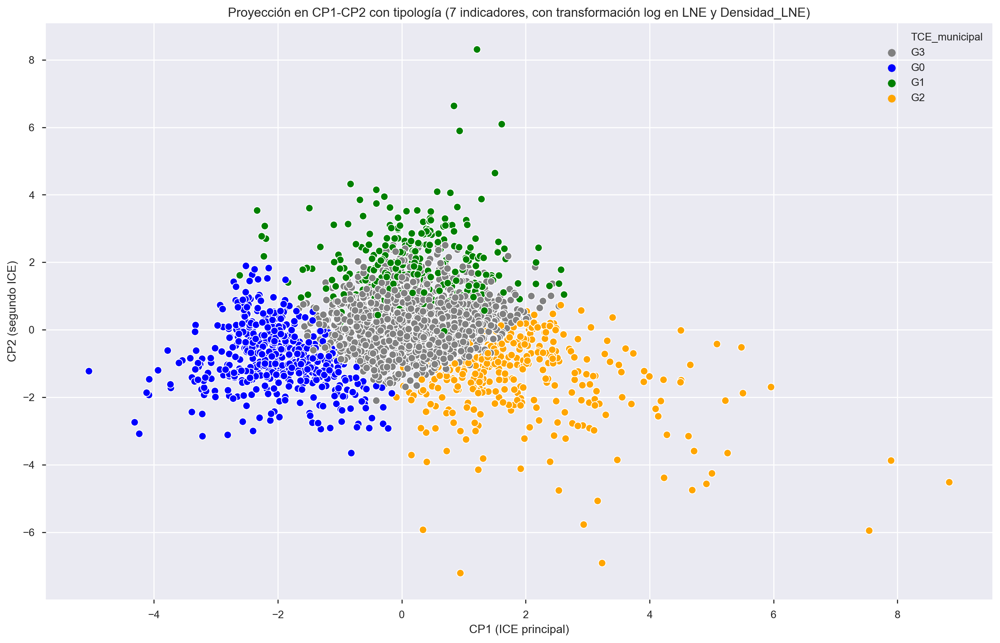

In [30]:
#Scatter plot (seaborn) CP1 vs CP2 (con clustering k-means)

plt.figure(figsize=(16, 10), dpi= 200, facecolor='w', edgecolor='k')
sns.scatterplot(x="CP1", y="CP2", 
                data=df_pca_results_ind7_tf_kmeans, 
                hue="TCE_municipal",
                palette=color_dict)
# Set x-axis label
plt.xlabel('CP1 (ICE principal)')
# Set y-axis label
plt.ylabel('CP2 (segundo ICE)')
plt.title('Proyección en CP1-CP2 con tipología (7 indicadores, con transformación log en LNE y Densidad_LNE)')

plt.savefig('Pyplot_PCA_Kmeans_ind7_tf.png',dpi=600)

Gráfica en el espacio CP1, CP2, CP3

In [31]:
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.lines import Line2D

#para definir los colores
colores = df_pca_results_ind7_tf_kmeans['TCE_municipal'].apply(lambda x: color_dict[x])

#figura
fig = pyplot.figure(figsize=(16, 10), dpi=600, facecolor='w', edgecolor='k')
ax = Axes3D(fig)
ax.scatter(df_pca_results_ind7_tf_kmeans['CP1'], df_pca_results_ind7_tf_kmeans['CP2'], df_pca_results_ind7_tf_kmeans['CP3'], c=colores,s=15)
# ax.set_xlim3d(-10, 40)
ax.set_ylim3d(-7.5,7.5)
ax.set_zlim3d(-2,8)
ax.set_xlabel('CP1 (ICE principal)')
ax.set_ylabel('CP2 (segundo ICE)')
ax.set_zlabel('CP3 (tercer ICE)')
ax.view_init(elev, azim)
ax.legend(title='TCE_municipal', handles=legend_elements_4, loc='center right',fontsize='x-large')
ax.set_title('Proyección en CP1-CP2-CP3 con tipología (7 indicadores, con transformación log en LNE y Densidad_LNE)')

plt.savefig('Pyplot_PCA_3d_Kmeans_ind7_tf.png',dpi=600)
pyplot.show()

Gráfica 3d animada

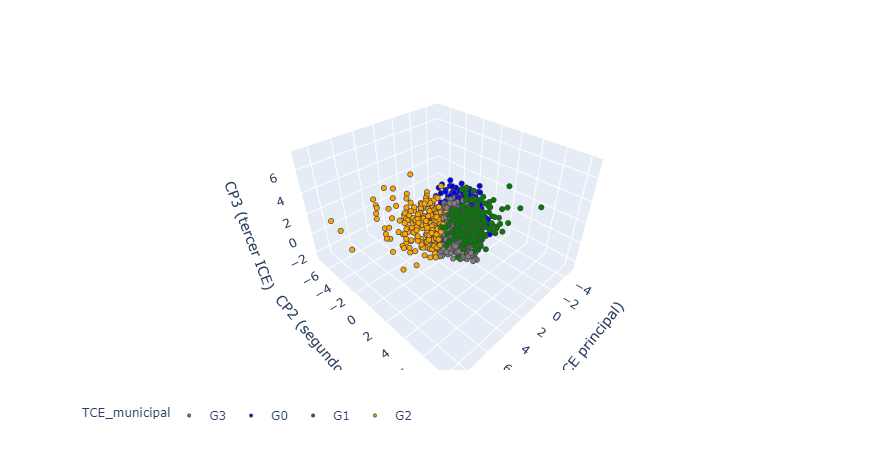

In [32]:
#3-d plot con plotly
fig = px.scatter_3d(df_pca_results_ind7_tf_kmeans, x='CP1', y='CP2', z='CP3',
              color='TCE_municipal',
                    color_discrete_map={
                  'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey',
                  'G4': 'red',
                  'G5': 'magenta'})
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                 legend_orientation="h")
fig.show()

<br>

# Escenario 3: TCE con 5 clusters y 8 indicadores

Se utiliza la última iteración guardada de K-medias para asegurar la reproducibilidad de los resultados (recordando que K-medias es un algoritmo estocástico; y por lo tanto, en cada iteración hay variaciones en la asignación de grupos).

In [33]:
#df_pca_results_ind8_kmeans = pd.read_csv("Resultados_Mun_PCA_Kmeans_ind8.csv", dtype={'EDO':int,'MUN':int,'CP1':float, 'CP2':float, 'CP3':float})
df_pca_results_ind8_kmeans.head()

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-1.212730,0.714345,0.923540,-0.603382,-0.084640,-0.782450,-0.261916,-0.003056,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.406688,-1.362798,0.754667,0.415810,-0.885600,0.272844,-1.093298,0.029088,G0
2,1,AGUASCALIENTES,9,TEPEZALA,-2.795431,-0.391567,1.266848,0.337623,-0.693461,-0.657287,-0.864759,0.099806,G0
3,1,AGUASCALIENTES,11,EL LLANO,-2.524197,-0.487015,0.724376,0.172457,-0.717782,-0.340382,-0.187773,-0.019983,G0
4,1,AGUASCALIENTES,2,ASIENTOS,-2.419575,-0.569647,0.875752,0.915294,-0.718031,-0.391693,-0.592203,-0.023749,G0


Gráfica en el espacio CP1, CP2

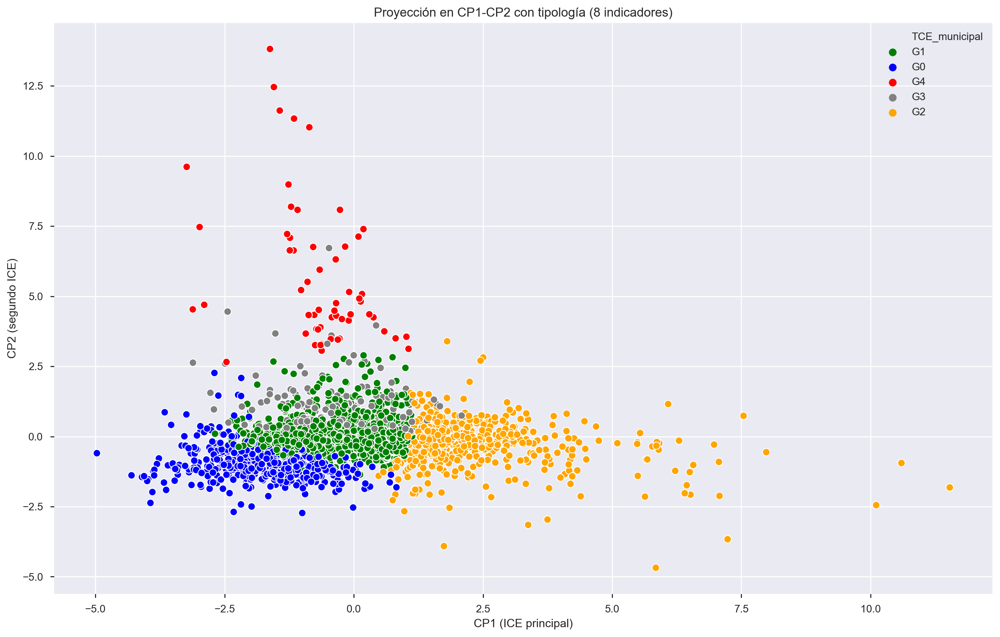

In [34]:
#Scatter plot (seaborn) PC1 vs PC2 (con clustering k-means)

plt.figure(figsize=(16, 10), dpi= 200, facecolor='w', edgecolor='k')
sns.scatterplot(x="CP1", y="CP2", 
                data=df_pca_results_ind8_kmeans, 
                hue="TCE_municipal",
                palette=color_dict)
# Set x-axis label
plt.xlabel('CP1 (ICE principal)')
# Set y-axis label
plt.ylabel('CP2 (segundo ICE)')
plt.title('Proyección en CP1-CP2 con tipología (8 indicadores)')

plt.savefig('Pyplot_PCA_Kmeans_ind8.png',dpi=600)

Gráfica en el espacio CP1, CP2, CP3

In [36]:
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.lines import Line2D

#para definir los colores
colores = df_pca_results_ind8_kmeans['TCE_municipal'].apply(lambda x: color_dict[x])

#figura
fig = pyplot.figure(figsize=(16, 10), dpi=600, facecolor='w', edgecolor='k')
ax = Axes3D(fig)
ax.scatter(df_pca_results_ind8_kmeans['CP1'], df_pca_results_ind8_kmeans['CP2'], df_pca_results_ind8_kmeans['CP3'], c=colores,s=15)
# ax.set_xlim3d(-10, 40)
ax.set_ylim3d(-9,12)
ax.set_zlim3d(-2,8)
ax.set_xlabel('CP1 (ICE principal)')
ax.set_ylabel('CP2 (segundo ICE)')
ax.set_zlabel('CP3 (tercer ICE)')
ax.view_init(elev, azim)
ax.legend(title='TCE_municipal', handles=legend_elements_5, loc='center right',fontsize='x-large')
ax.set_title('Proyección en CP1-CP2-CP3 con tipología (8 indicadores)')

plt.savefig('Pyplot_PCA_3d_Kmeans_ind8.png',dpi=600)
pyplot.show()

Gráfica 3d animada

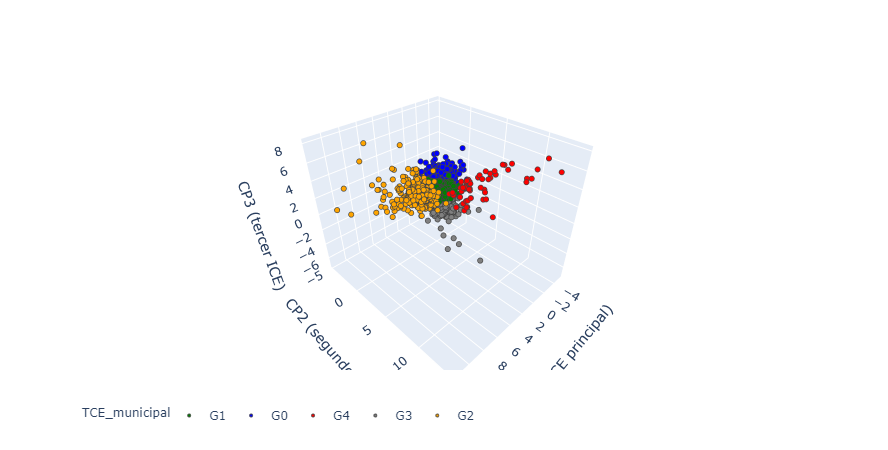

In [37]:
#3-d plot con plotly
fig = px.scatter_3d(df_pca_results_ind8_kmeans, x='CP1', y='CP2', z='CP3',
              color='TCE_municipal',
                    color_discrete_map={
                  'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey',
                  'G4': 'red',
                  'G5': 'magenta'})
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                 legend_orientation="h")
fig.show()

<br>

# Escenario 4: TCE con 4 clusters y 8 indicadores (con transformación log en LNE y Densidad_LNE)

Se utiliza la última iteración guardada de K-medias para asegurar la reproducibilidad de los resultados (recordando que K-medias es un algoritmo estocástico; y por lo tanto, en cada iteración hay variaciones en la asignación de grupos).

In [38]:
#df_pca_results_ind8_tf_kmeans = pd.read_csv("Resultados_Mun_PCA_Kmeans_ind8_tf.csv", dtype={'EDO':int,'MUN':int,'CP1':float, 'CP2':float, 'CP3':float})
df_pca_results_ind8_tf_kmeans.head()

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,CP1,CP2,CP3,CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,-1.214070,0.513032,-1.450945,0.431519,0.182643,-0.259314,-0.187243,0.010094,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,-3.422301,-1.284015,0.577059,0.648052,-0.969611,-0.638014,-1.147983,0.037785,G2
2,1,AGUASCALIENTES,9,TEPEZALA,-2.820073,-0.517094,-1.072523,1.362320,-0.340752,0.004996,-0.799488,0.107345,G2
3,1,AGUASCALIENTES,11,EL LLANO,-2.557359,-0.295472,-0.890254,0.975709,-0.418065,-0.044813,-0.157649,-0.013624,G2
4,1,AGUASCALIENTES,2,ASIENTOS,-2.449705,-0.118811,-0.643405,1.811638,-0.307746,-0.200200,-0.563693,-0.009320,G2


Gráfica en el espacio CP1, CP2

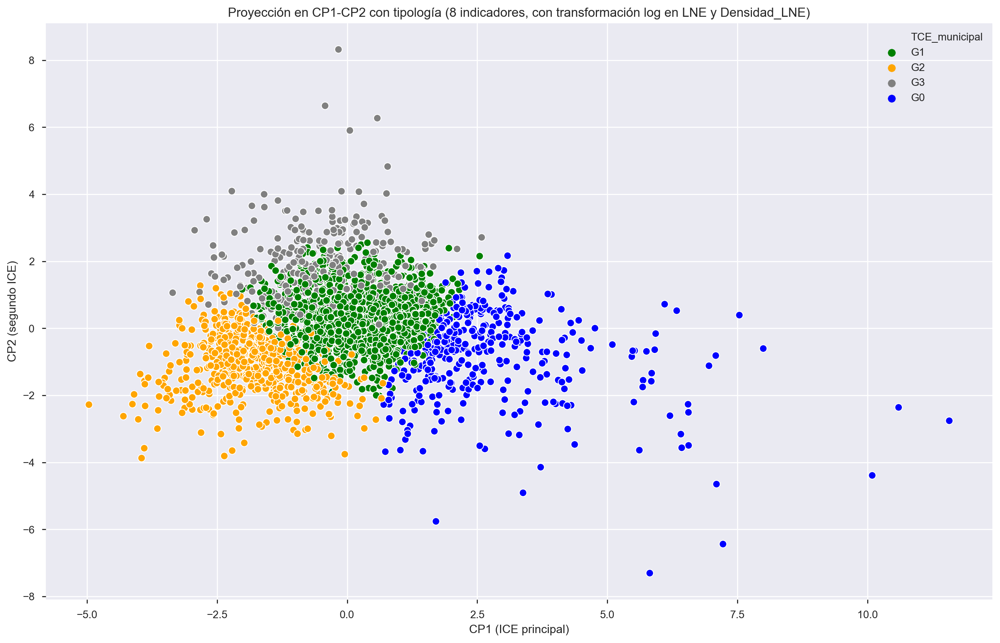

In [39]:
#Scatter plot (seaborn) PC1 vs PC2 (con clustering k-means)

plt.figure(figsize=(16, 10), dpi= 200, facecolor='w', edgecolor='k')
sns.scatterplot(x="CP1", y="CP2", 
                data=df_pca_results_ind8_tf_kmeans, 
                hue="TCE_municipal",
                palette=color_dict)
# Set x-axis label
plt.xlabel('CP1 (ICE principal)')
# Set y-axis label
plt.ylabel('CP2 (segundo ICE)')
plt.title('Proyección en CP1-CP2 con tipología (8 indicadores, con transformación log en LNE y Densidad_LNE)')

plt.savefig('Pyplot_PCA_Kmeans_ind8_tf.png',dpi=600)

Gráfica en el espacio CP1, CP2, CP3

In [40]:
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.lines import Line2D

#para definir los colores
colores = df_pca_results_ind8_tf_kmeans['TCE_municipal'].apply(lambda x: color_dict[x])

#figura
fig = pyplot.figure(figsize=(16, 10), dpi=600, facecolor='w', edgecolor='k')
ax = Axes3D(fig)
ax.scatter(df_pca_results_ind8_tf_kmeans['CP1'], df_pca_results_ind8_tf_kmeans['CP2'], df_pca_results_ind8_tf_kmeans['CP3'], c=colores,s=15)
# ax.set_xlim3d(-10, 40)
ax.set_ylim3d(-7.5,7.5)
ax.set_zlim3d(-2,8)
ax.set_xlabel('CP1 (ICE principal)')
ax.set_ylabel('CP2 (segundo ICE)')
ax.set_zlabel('CP3 (tercer ICE)')
ax.view_init(elev, azim)
ax.legend(title='TCE_municipal', handles=legend_elements_4, loc='center right',fontsize='x-large')
ax.set_title('Proyección en CP1-CP2-CP3 con tipología (8 indicadores, con transformación log en LNE y Densidad_LNE)')

plt.savefig('Pyplot_PCA_3d_Kmeans_ind8_tf.png',dpi=600)
pyplot.show()

Gráfica 3d animada

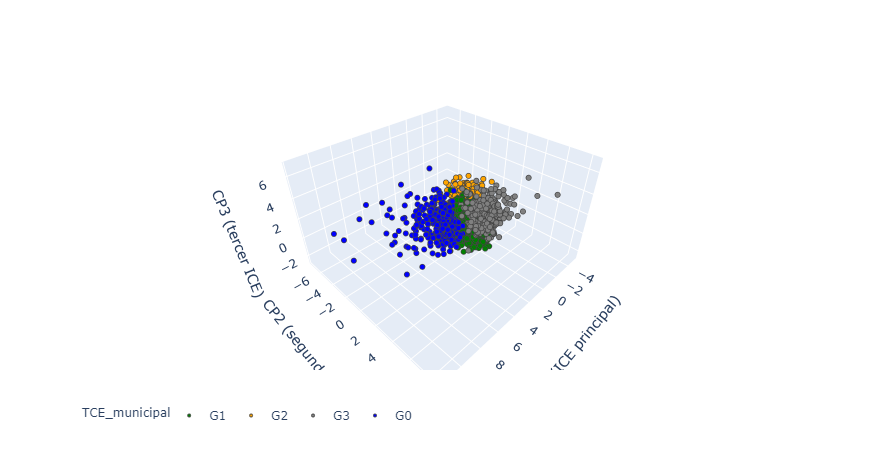

In [41]:
#3-d plot con plotly
fig = px.scatter_3d(df_pca_results_ind8_tf_kmeans, x='CP1', y='CP2', z='CP3',
              color='TCE_municipal',
                    color_discrete_map={
                  'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey',
                  'G4': 'red',
                  'G5': 'magenta'})
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                 legend_orientation="h")
fig.show()

<br>

# Análisis estadístico de los ICE y la TCE municipal 


## Escenario 1: (7 indicadores)

In [42]:
#unimos los resultados de PCA_Kmeans con los metadatos y los 7 indicadores de los municipios
df_indi_pca_kmeans_ind7=pd.merge(datos_mun_limpio, df_pca_results_ind7_kmeans, on=['EDO','NOMBRE_ESTADO','MUN','NOMBRE_MUNICIPIO'], how='inner')

#renombramos algunas columnas_pca
df_indi_pca_kmeans_ind7=df_indi_pca_kmeans_ind7.rename(columns={"CP1": "CP1 (ICE principal)", "CP2": "CP2 (segundo ICE)", "CP3": "CP3 (tercer ICE)"})

df_indi_pca_kmeans_ind7

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,Var_Prop_LNE,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34917.0,3566.024547,0.989272,0.037498,0.015085,0.017733,0.755939,-1.061899,0.788043,-0.837586,-0.614461,-0.088128,-0.782747,-0.238578,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,6914.0,46.444421,0.991803,0.000289,0.008345,0.008887,0.237061,-3.242619,-1.163180,-0.391435,0.193575,0.880911,0.128676,-1.012632,G0
2,1,AGUASCALIENTES,9,TEPEZALA,6,15545.0,2478.675412,0.990635,0.005108,0.011777,0.011921,0.344567,-2.714649,-0.207140,-0.939179,0.184211,0.615393,-0.770295,-0.744057,G0
3,1,AGUASCALIENTES,11,EL LLANO,6,15067.0,1505.749552,0.991016,-0.003373,0.012239,0.014232,0.504020,-2.489077,-0.324405,-0.411126,-0.029804,0.468563,-0.389211,-0.141379,G0
4,1,AGUASCALIENTES,2,ASIENTOS,11,34222.0,1484.722551,0.989080,0.001874,0.013432,0.015397,0.374738,-2.499466,-0.395191,-0.509621,0.718468,0.620966,-0.484175,-0.511286,G0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,13,6959.0,36.438707,0.983523,0.066677,0.019408,0.021905,0.959378,0.548172,-0.308683,0.679952,0.209243,-0.452260,0.088731,-0.062292,G1
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,17372.0,14.595272,0.986450,0.082705,0.022769,0.026072,0.984897,0.875699,0.306366,1.949664,0.996421,0.061302,-0.572234,-0.267121,G2
2455,32,ZACATECAS,44,TABASCO,16,12527.0,53.144872,0.983221,0.100307,0.029823,0.035416,0.993335,1.864008,-0.162682,0.715202,0.470561,0.292022,-0.127472,-0.194333,G4
2456,32,ZACATECAS,9,CHALCHIHUITES,10,8222.0,599.837116,0.982861,0.075052,0.021097,0.024771,0.988608,0.886651,-0.151959,0.337662,0.033250,-0.481215,-0.003173,-0.078652,G1



### Gráficas (pair-plot, box-plots, violin-plots)

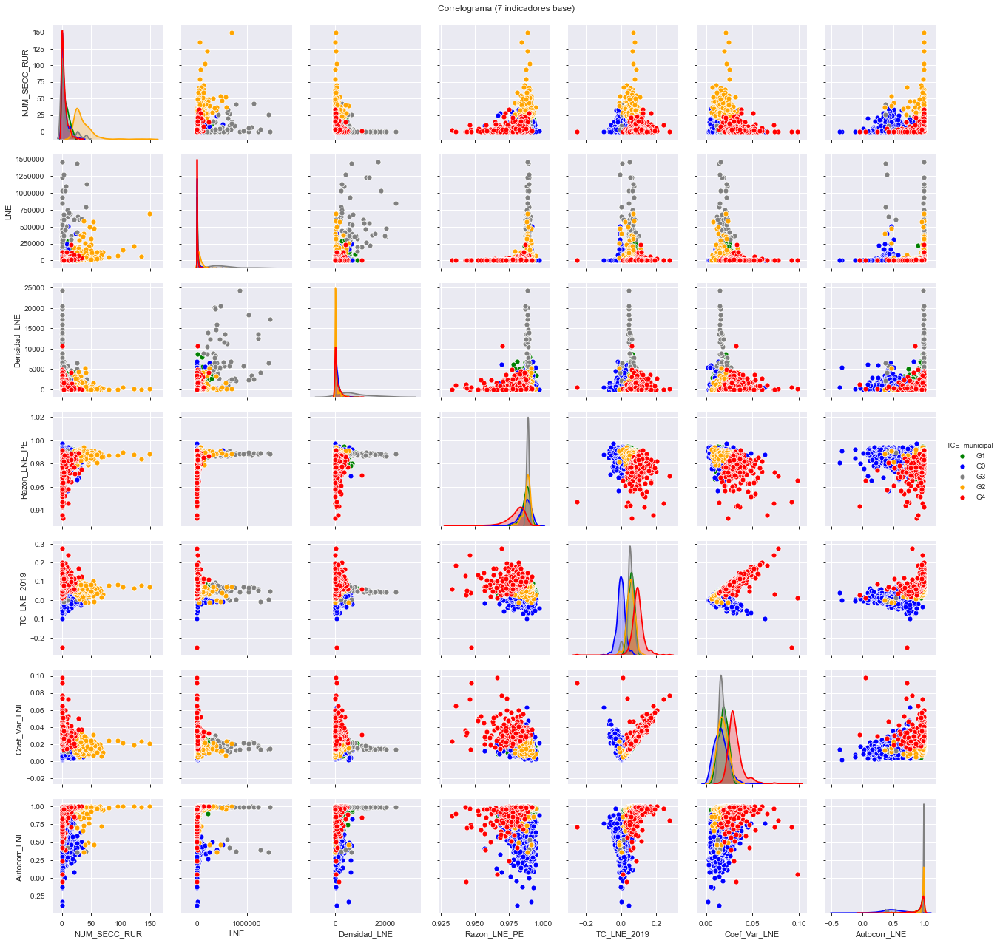

In [43]:
#sólo tomamos los indicadores y grupos
df_indi_pca_kmeans_ind7_f = df_indi_pca_kmeans_ind7[['NUM_SECC_RUR','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE', 'TCE_municipal']]
#pair-plot (colores en funcion de grupo)
corr3=sns.pairplot(df_indi_pca_kmeans_ind7_f, 
                   hue="TCE_municipal",
                   palette=color_dict)
corr3.fig.suptitle("Correlograma (7 indicadores base)", y=1.01)

#guardar la pair-plot
corr3.savefig('Pyplot_correlogram_TCE_ind7.png',dpi=600)

Plotgrid de gráficas de caja para cada indicador e índice de complejidad electoral (por grupo)

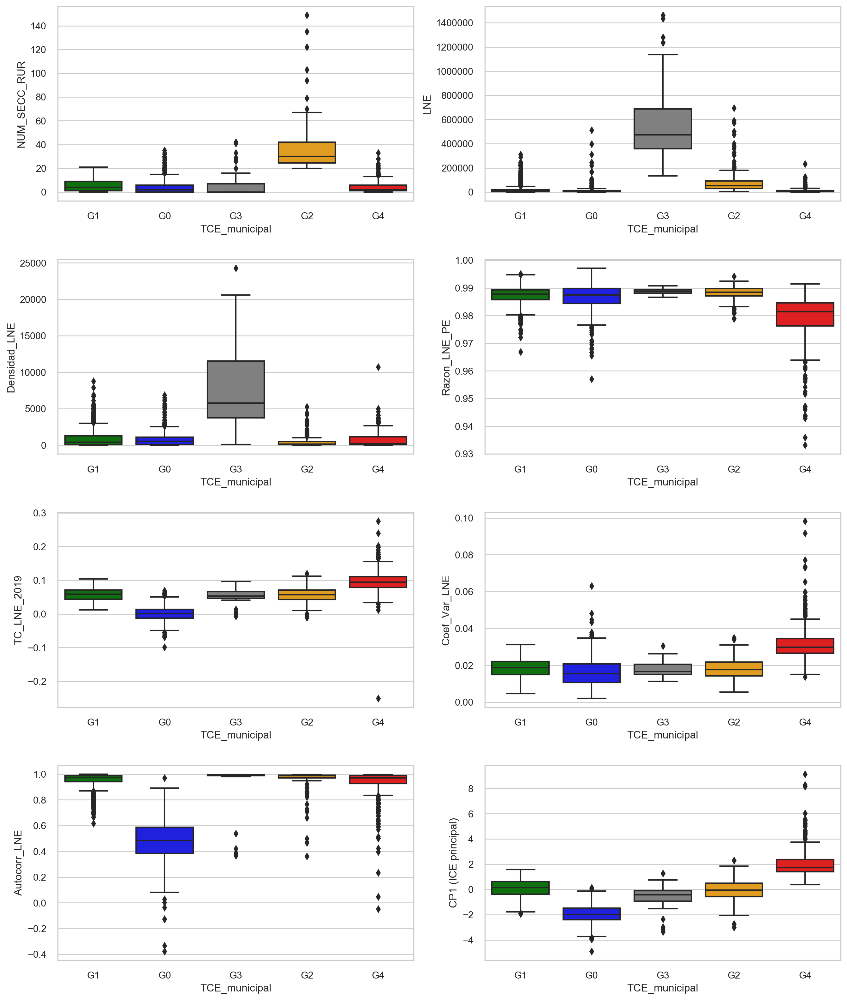

In [44]:
sns.set(style="whitegrid")
fig, axes = plt.subplots(4, 2, figsize=(16, 20), dpi= 200)

ax = sns.boxplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["LNE"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["Densidad_LNE"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["CP1 (ICE principal)"], palette=color_dict, orient='v', 
    ax=axes[3, 1])

#fig.delaxes(axes[4][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical
#se guarda la gráfica
plt.savefig('Pyplot_box-plots-grid_TCE_ind7.png',dpi=600)
plt.show()

Gráfica de violín (por grupos, para el indicador "CP1")

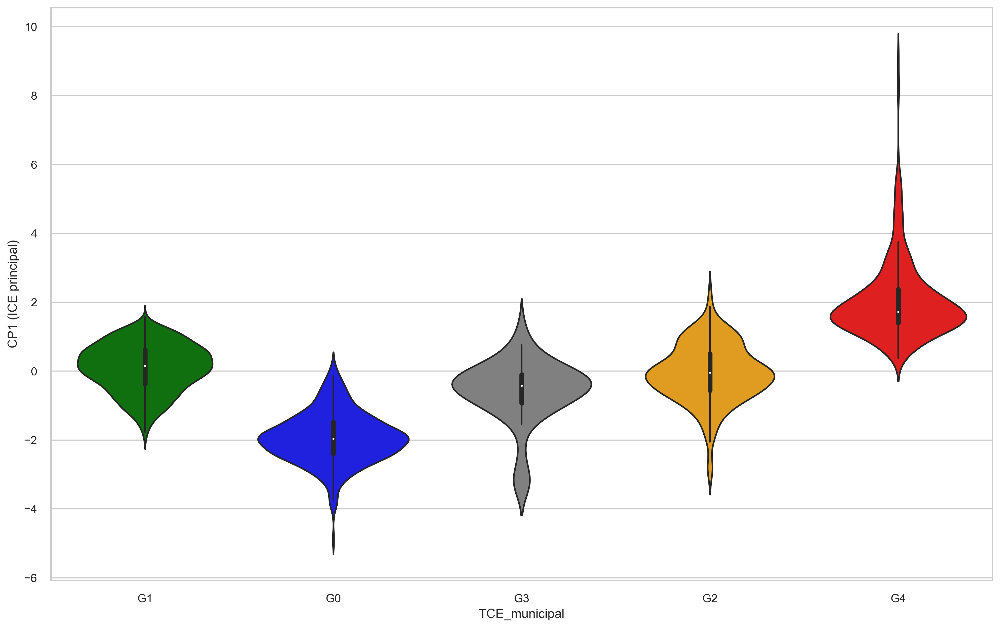

In [45]:
plt.figure(figsize=(16, 10), dpi= 300, facecolor='w', edgecolor='k')
sns.violinplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["CP1 (ICE principal)"], palette=color_dict);
#se guarda la gráfica
plt.savefig('Pyplot_violin_TCE_ind7.png',dpi=600)
plt.show()

Plotgrid de gráficas de violín para cada indicador e índice de complejidad electoral (por grupo)

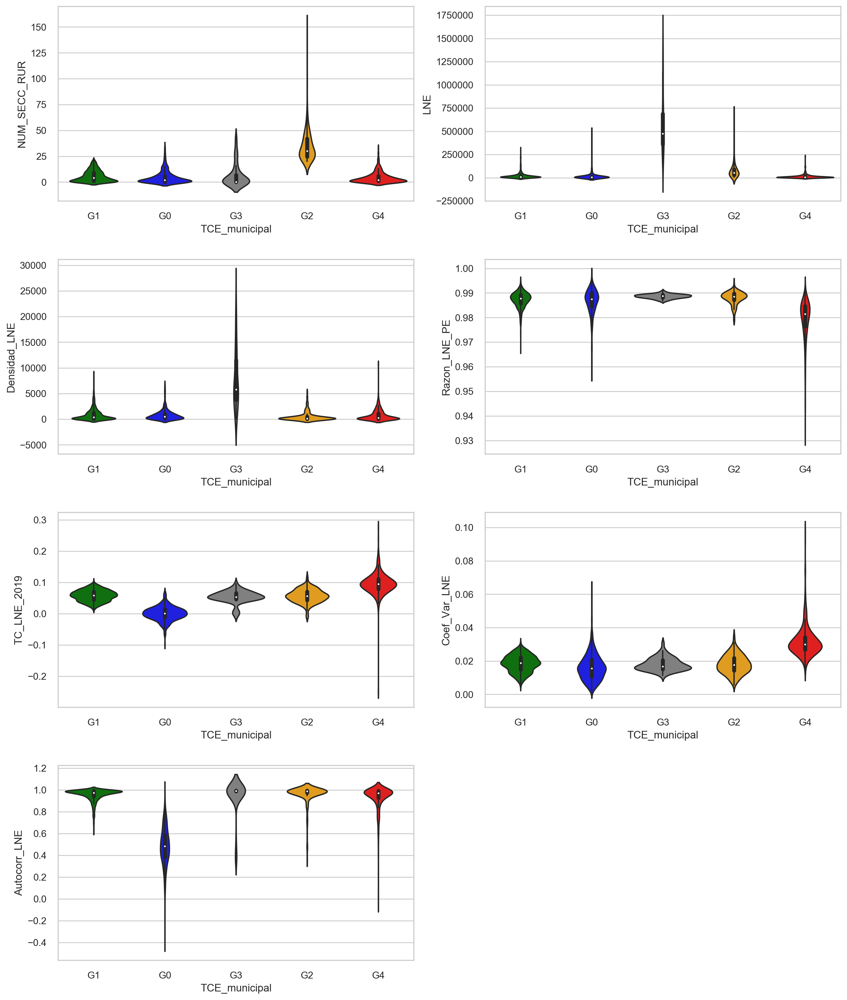

In [46]:
sns.set(style="whitegrid")

fig, axes = plt.subplots(4, 2, figsize=(16, 20), dpi= 200)
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["LNE"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["Densidad_LNE"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7["TCE_municipal"], y=df_indi_pca_kmeans_ind7["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])

fig.delaxes(axes[3][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical

#se guarda la gráfica
plt.savefig('Pyplot_violin-plot-grid_TCE_ind7.png',dpi=600)
plt.show()


### Identificación de los valores/municipios atípicos (7 indicadores)
Etiquetamos los municipios considerados como atípicos en los ICE (considerando la separación por grupos de la tipología, y utilizando la regla intercuartil):

In [47]:
#ejemplo:
df_indi_pca_kmeans_ind7['CP1 (ICE principal)'].quantile(0.25)

-0.8920578135997572

In [48]:
def IQsR_clusters(x):
    x_0 = x['TCE_municipal'] == 'G0'
    x_g0 = x[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    return IQR_pc1_g0+IQR_pc1_g0;

In [49]:
IQsR_clusters(df_indi_pca_kmeans_ind7)

1.846854063600924

Función para calcular el Q1, Q3 e IQR (calculado por grupos de cluster_Kmeans), y posteriormente clasificar los municipios en tipicos o atipicos en el ICE principal.

In [50]:
def IQR_clusters(x):
    x_0 = df_indi_pca_kmeans_ind7['TCE_municipal'] == 'G0'
    x_g0 = df_indi_pca_kmeans_ind7[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    
    x_1 = df_indi_pca_kmeans_ind7['TCE_municipal'] == 'G1'
    x_g1 = df_indi_pca_kmeans_ind7[x_1]
    Q1_g1 = x_g1['CP1 (ICE principal)'].quantile(0.25)
    Q3_g1 = x_g1['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g1 = Q3_g1 - Q1_g1
    Q1_pc2_g1 =  x_g1['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g1 = x_g1['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g1 = Q3_pc2_g1 - Q1_pc2_g1
    Q1_pc3_g1 =  x_g1['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g1 = x_g1['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g1 = Q3_pc3_g1 - Q1_pc3_g1
    
    x_2 = df_indi_pca_kmeans_ind7['TCE_municipal'] == 'G2'
    x_g2 = df_indi_pca_kmeans_ind7[x_2]
    Q1_g2 = x_g2['CP1 (ICE principal)'].quantile(0.25)
    Q3_g2 = x_g2['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g2 = Q3_g2 - Q1_g2
    Q1_pc2_g2 =  x_g2['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g2 = x_g2['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g2 = Q3_pc2_g2 - Q1_pc2_g2
    Q1_pc3_g2 =  x_g2['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g2 = x_g2['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g2 = Q3_pc3_g2 - Q1_pc3_g2
    
    x_3 = df_indi_pca_kmeans_ind7['TCE_municipal'] == 'G3'
    x_g3 = df_indi_pca_kmeans_ind7[x_3]
    Q1_g3 = x_g3['CP1 (ICE principal)'].quantile(0.25)
    Q3_g3 = x_g3['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g3 = Q3_g3 - Q1_g3
    Q1_pc2_g3 =  x_g3['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g3 = x_g3['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g3 = Q3_pc2_g3 - Q1_pc2_g3
    Q1_pc3_g3 =  x_g3['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g3 = x_g3['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g3 = Q3_pc3_g3 - Q1_pc3_g3
    
    x_4 = df_indi_pca_kmeans_ind7['TCE_municipal'] == 'G4'
    x_g4 = df_indi_pca_kmeans_ind7[x_4]
    Q1_g4 = x_g4['CP1 (ICE principal)'].quantile(0.25)
    Q3_g4 = x_g4['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g4 = Q3_g4 - Q1_g4
    Q1_pc2_g4 =  x_g4['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g4 = x_g4['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g4 = Q3_pc2_g4 - Q1_pc2_g4
    Q1_pc3_g4 =  x_g4['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g4 = x_g4['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g4 = Q3_pc3_g4 - Q1_pc3_g4
    
#     x_5 = df_indi_pca_kmeans_ind7['TCE_municipal'] == 'G5'
#     x_g5 = df_indi_pca_kmeans_ind7[x_5]
#     Q1_g5 = x_g5['CP1 (ICE principal)'].quantile(0.25)
#     Q3_g5 = x_g5['CP1 (ICE principal)'].quantile(0.75)
#     IQR_pc1_g5 = Q3_g5 - Q1_g5
#     Q1_pc2_g5 =  x_g5['CP2 (segundo ICE)'].quantile(0.25)
#     Q3_pc2_g5 = x_g5['CP2 (segundo ICE)'].quantile(0.75)
#     IQR_pc2_g5 = Q3_pc2_g5 - Q1_pc2_g5
#     Q1_pc3_g5 =  x_g5['CP3 (tercer ICE)'].quantile(0.25)
#     Q3_pc3_g5 = x_g5['CP3 (tercer ICE)'].quantile(0.75)
#     IQR_pc3_g5 = Q3_pc3_g5 - Q1_pc3_g5
    
    if (x['TCE_municipal'] == 'G0'):
        if (x['CP1 (ICE principal)'] < Q1_g0-1.5*IQR_pc1_g0) or (x['CP1 (ICE principal)'] > Q3_g0+1.5*IQR_pc1_g0):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g0-1.5*IQR_pc2_g0) or (x['CP2 (segundo ICE)'] > Q3_pc2_g0+1.5*IQR_pc2_g0):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g0-1.5*IQR_pc3_g0) or (x['CP3 (tercer ICE)'] > Q3_pc3_g0+1.5*IQR_pc3_g0):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G1'):
        if (x['CP1 (ICE principal)'] < Q1_g1-1.5*IQR_pc1_g1) or (x['CP1 (ICE principal)'] > Q3_g1+1.5*IQR_pc1_g1):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g1-1.5*IQR_pc2_g1) or (x['CP2 (segundo ICE)'] > Q3_pc2_g1+1.5*IQR_pc2_g1):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g1-1.5*IQR_pc3_g1) or (x['CP3 (tercer ICE)'] > Q3_pc3_g1+1.5*IQR_pc3_g1):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G2'):
        if (x['CP1 (ICE principal)'] < Q1_g2-1.5*IQR_pc1_g2) or (x['CP1 (ICE principal)'] > Q3_g2+1.5*IQR_pc1_g2):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g2-1.5*IQR_pc2_g2) or (x['CP2 (segundo ICE)'] > Q3_pc2_g2+1.5*IQR_pc2_g2):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g2-1.5*IQR_pc3_g2) or (x['CP3 (tercer ICE)'] > Q3_pc3_g2+1.5*IQR_pc3_g2):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G3'):
        if (x['CP1 (ICE principal)'] < Q1_g3-1.5*IQR_pc1_g3) or (x['CP1 (ICE principal)'] > Q3_g3+1.5*IQR_pc1_g3):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g3-1.5*IQR_pc2_g3) or (x['CP2 (segundo ICE)'] > Q3_pc2_g3+1.5*IQR_pc2_g3):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g3-1.5*IQR_pc3_g3) or (x['CP3 (tercer ICE)'] > Q3_pc3_g3+1.5*IQR_pc3_g3):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G4'):
        if (x['CP1 (ICE principal)'] < Q1_g4-1.5*IQR_pc1_g4) or (x['CP1 (ICE principal)'] > Q3_g4+1.5*IQR_pc1_g4):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g4-1.5*IQR_pc2_g4) or (x['CP2 (segundo ICE)'] > Q3_pc2_g4+1.5*IQR_pc2_g4):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g4-1.5*IQR_pc3_g4) or (x['CP3 (tercer ICE)'] > Q3_pc3_g4+1.5*IQR_pc3_g4):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
#     elif (x['TCE_municipal'] == 'G5'):
#         if (x['CP1 (ICE principal)'] < Q1_g5-1.5*IQR_pc1_g5) or (x['CP1 (ICE principal)'] > Q3_g5+1.5*IQR_pc1_g5):
#             return 'Atípica en ICE principal'
#         elif (x['CP2 (segundo ICE)'] < Q1_pc2_g5-1.5*IQR_pc2_g5) or (x['CP2 (segundo ICE)'] > Q3_pc2_g5+1.5*IQR_pc2_g5):
#             return 'Atípica en segundo ICE'
#         elif (x['CP3 (tercer ICE)'] < Q1_pc3_g5-1.5*IQR_pc3_g5) or (x['CP3 (tercer ICE)'] > Q3_pc3_g5+1.5*IQR_pc3_g5):
#             return 'Atípica en tercer ICE'
#         else:
#             return 'Tipica'
    else:
        return 'nan'

In [51]:
#se aplica la función al último df con los resultados:
df_indi_pca_kmeans_ind7['Atipicidad'] = df_indi_pca_kmeans_ind7.apply(IQR_clusters, axis = 1)

#se muestra el dataframe:
df_indi_pca_kmeans_ind7

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34917.0,3566.024547,0.989272,0.037498,0.015085,...,0.755939,-1.061899,0.788043,-0.837586,-0.614461,-0.088128,-0.782747,-0.238578,G1,Tipica
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,6914.0,46.444421,0.991803,0.000289,0.008345,...,0.237061,-3.242619,-1.163180,-0.391435,0.193575,0.880911,0.128676,-1.012632,G0,Tipica
2,1,AGUASCALIENTES,9,TEPEZALA,6,15545.0,2478.675412,0.990635,0.005108,0.011777,...,0.344567,-2.714649,-0.207140,-0.939179,0.184211,0.615393,-0.770295,-0.744057,G0,Tipica
3,1,AGUASCALIENTES,11,EL LLANO,6,15067.0,1505.749552,0.991016,-0.003373,0.012239,...,0.504020,-2.489077,-0.324405,-0.411126,-0.029804,0.468563,-0.389211,-0.141379,G0,Tipica
4,1,AGUASCALIENTES,2,ASIENTOS,11,34222.0,1484.722551,0.989080,0.001874,0.013432,...,0.374738,-2.499466,-0.395191,-0.509621,0.718468,0.620966,-0.484175,-0.511286,G0,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,13,6959.0,36.438707,0.983523,0.066677,0.019408,...,0.959378,0.548172,-0.308683,0.679952,0.209243,-0.452260,0.088731,-0.062292,G1,Tipica
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,17372.0,14.595272,0.986450,0.082705,0.022769,...,0.984897,0.875699,0.306366,1.949664,0.996421,0.061302,-0.572234,-0.267121,G2,Tipica
2455,32,ZACATECAS,44,TABASCO,16,12527.0,53.144872,0.983221,0.100307,0.029823,...,0.993335,1.864008,-0.162682,0.715202,0.470561,0.292022,-0.127472,-0.194333,G4,Tipica
2456,32,ZACATECAS,9,CHALCHIHUITES,10,8222.0,599.837116,0.982861,0.075052,0.021097,...,0.988608,0.886651,-0.151959,0.337662,0.033250,-0.481215,-0.003173,-0.078652,G1,Tipica


In [52]:
#para verificar, imprimimos los valores únicos en la columna Atipicidad.
df_indi_pca_kmeans_ind7.Atipicidad.unique()

array(['Tipica', 'Atípica en segundo ICE', 'Atípica en ICE principal',
       'Atípica en tercer ICE'], dtype=object)

In [53]:
#imprimimos la frecuencia de los valores únicos en Atipicidad
df_indi_pca_kmeans_ind7['Atipicidad'].value_counts()

Tipica                      2245
Atípica en segundo ICE       146
Atípica en ICE principal      51
Atípica en tercer ICE         16
Name: Atipicidad, dtype: int64

In [54]:
#imprimimos el número de municipios por grupo de la tipología.
df_indi_pca_kmeans_ind7['TCE_municipal'].value_counts()

G1    1288
G0     485
G4     428
G2     199
G3      58
Name: TCE_municipal, dtype: int64

In [55]:
#se guardan los resultados en un csv
df_indi_pca_kmeans_ind7.to_csv(r'Resultados_Mun_Indic_PCA_Kmeans_Atip_ind7.csv', index = None)

<br>

## Escenario 2: 7 indicadores (con transformación log en LNE y Densidad_LNE)

In [56]:
#unimos los resultados de PCA_Kmeans con los metadatos y los 7 indicadores de los municipios
df_indi_pca_kmeans_ind7_tf=pd.merge(datos_mun_limpio_tf, df_pca_results_ind7_tf_kmeans, on=['EDO','NOMBRE_ESTADO','MUN','NOMBRE_MUNICIPIO'], how='inner')

#renombramos algunas columnas_pca
df_indi_pca_kmeans_ind7_tf=df_indi_pca_kmeans_ind7_tf.rename(columns={"CP1": "CP1 (ICE principal)", 
                                                            "CP2": "CP2 (segundo ICE)", 
                                                            "CP3": "CP3 (tercer ICE)",
                                                           "LNE": "log(LNE)",
                                                           "Densidad_LNE": "log(Densidad_LNE)"})

df_indi_pca_kmeans_ind7_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,log(LNE),log(Densidad_LNE),Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,Var_Prop_LNE,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,10.460729,8.179207,0.989272,0.037498,0.015085,0.017733,0.755939,-0.995331,0.745533,-1.389633,0.434649,0.105639,-0.259502,-0.196240,G3
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,8.841304,3.838256,0.991803,0.000289,0.008345,0.008887,0.237061,-3.318903,-0.619987,0.723898,0.193995,-0.969311,-0.651817,-1.034857,G0
2,1,AGUASCALIENTES,9,TEPEZALA,6,9.651494,7.815480,0.990635,0.005108,0.011777,0.011921,0.344567,-2.757468,0.081456,-0.908153,1.115722,-0.558179,-0.004696,-0.705979,G0
3,1,AGUASCALIENTES,11,EL LLANO,6,9.620262,7.317046,0.991016,-0.003373,0.012239,0.014232,0.504020,-2.523745,0.260810,-0.738536,0.676101,-0.383889,-0.048412,-0.126217,G0
4,1,AGUASCALIENTES,2,ASIENTOS,11,10.440624,7.302983,0.989080,0.001874,0.013432,0.015397,0.374738,-2.490247,0.453746,-0.450692,1.507864,-0.496284,-0.207700,-0.497406,G0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,13,8.847791,3.595632,0.983523,0.066677,0.019408,0.021905,0.959378,0.566375,-0.038837,1.137560,-0.402981,0.304617,0.000411,-0.066702,G3
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,9.762615,2.680698,0.986450,0.082705,0.022769,0.026072,0.984897,1.080969,1.300230,2.208190,-0.057168,-0.342807,0.496959,-0.236424,G1
2455,32,ZACATECAS,44,TABASCO,16,9.435642,3.973022,0.983221,0.100307,0.029823,0.035416,0.993335,1.911600,0.178614,0.950089,0.065079,-0.393423,0.058249,-0.192537,G2
2456,32,ZACATECAS,9,CHALCHIHUITES,10,9.014569,6.396658,0.982861,0.075052,0.021097,0.024771,0.988608,0.851114,0.072100,-0.200368,0.061119,0.545074,0.389442,-0.072882,G3



### Gráficas (pair-plot, box-plots, violin-plots)

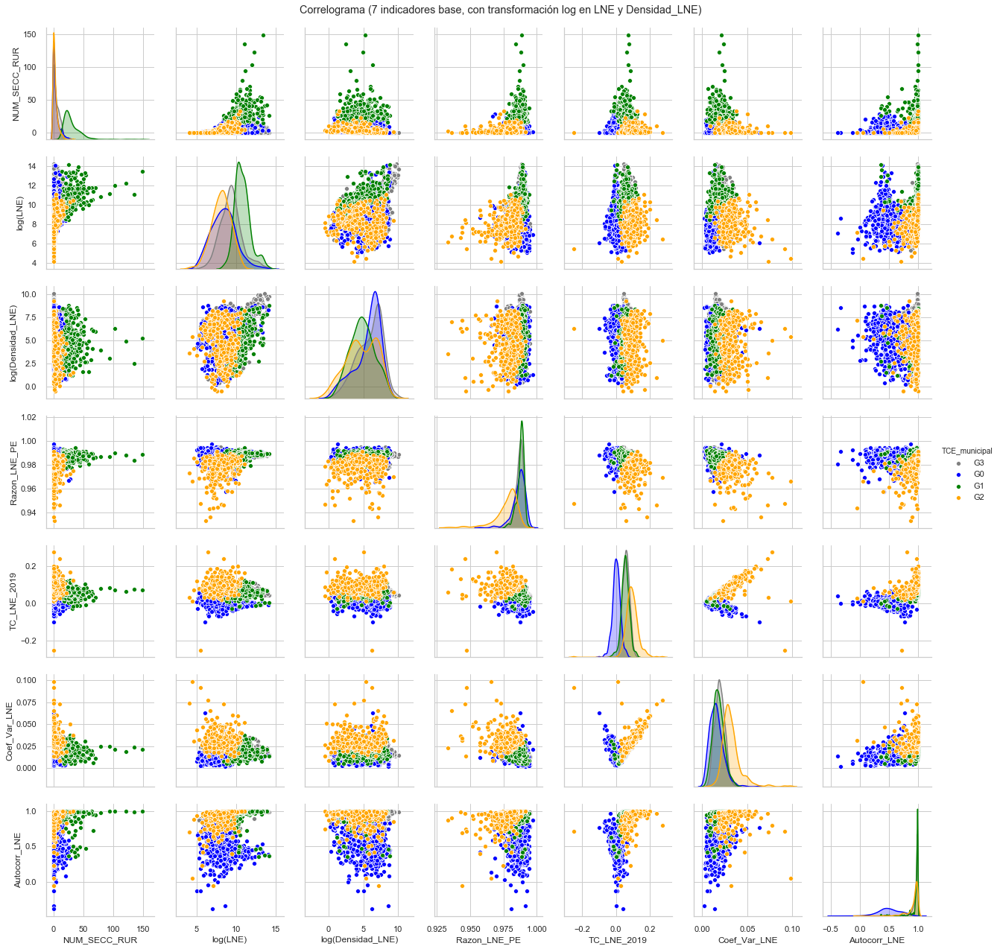

In [57]:
#sólo tomamos los indicadores y grupos
df_indi_pca_kmeans_ind7_tf_f = df_indi_pca_kmeans_ind7_tf[['NUM_SECC_RUR','log(LNE)', 'log(Densidad_LNE)', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE', 'TCE_municipal']]
#pair-plot (colores en funcion de grupo)
corr3_tf=sns.pairplot(df_indi_pca_kmeans_ind7_tf_f, 
                   hue="TCE_municipal",
                   palette=color_dict)
corr3_tf.fig.suptitle("Correlograma (7 indicadores base, con transformación log en LNE y Densidad_LNE)", y=1.01)

#guardar la pair-plot
corr3_tf.savefig('Pyplot_correlogram_TCE_ind7_tf.png',dpi=600)

Plotgrid de gráficas de caja para cada indicador e índice de complejidad electoral (por grupo)

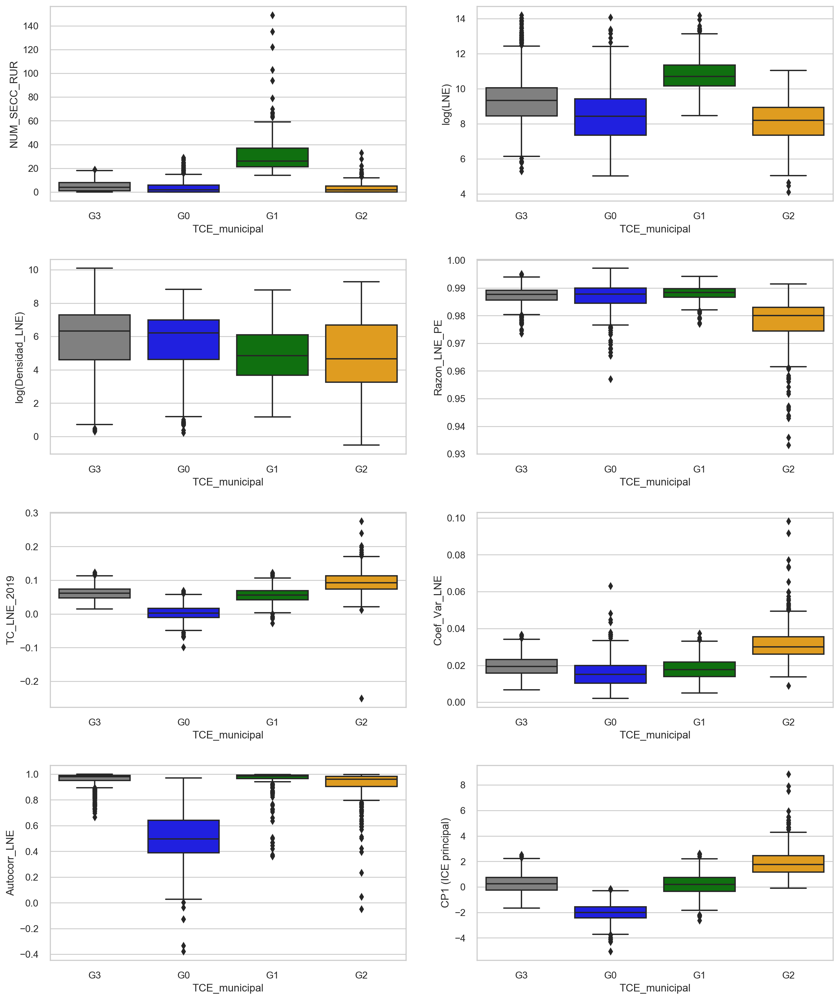

In [58]:
sns.set(style="whitegrid")
fig, axes = plt.subplots(4, 2, figsize=(16, 20), dpi= 200)

ax = sns.boxplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["log(LNE)"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["log(Densidad_LNE)"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["CP1 (ICE principal)"], palette=color_dict, orient='v', 
    ax=axes[3, 1])

#fig.delaxes(axes[4][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical
#se guarda la gráfica
plt.savefig('Pyplot_box-plots-grid_TCE_ind7_tf.png',dpi=600)
plt.show()

Gráfica de violín (por grupos, para el indicador "CP1")

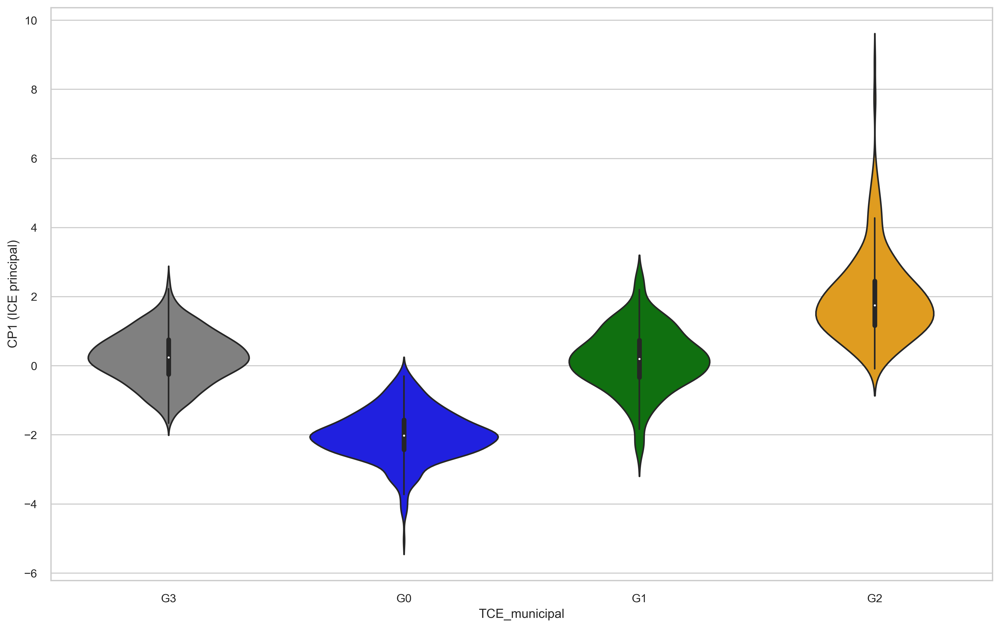

In [59]:
plt.figure(figsize=(16, 10), dpi= 300, facecolor='w', edgecolor='k')
sns.violinplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["CP1 (ICE principal)"], palette=color_dict);
#se guarda la gráfica
plt.savefig('Pyplot_violin_TCE_ind7_tf.png',dpi=600)
plt.show()

Plotgrid de gráficas de violín para cada indicador e índice de complejidad electoral (por grupo)

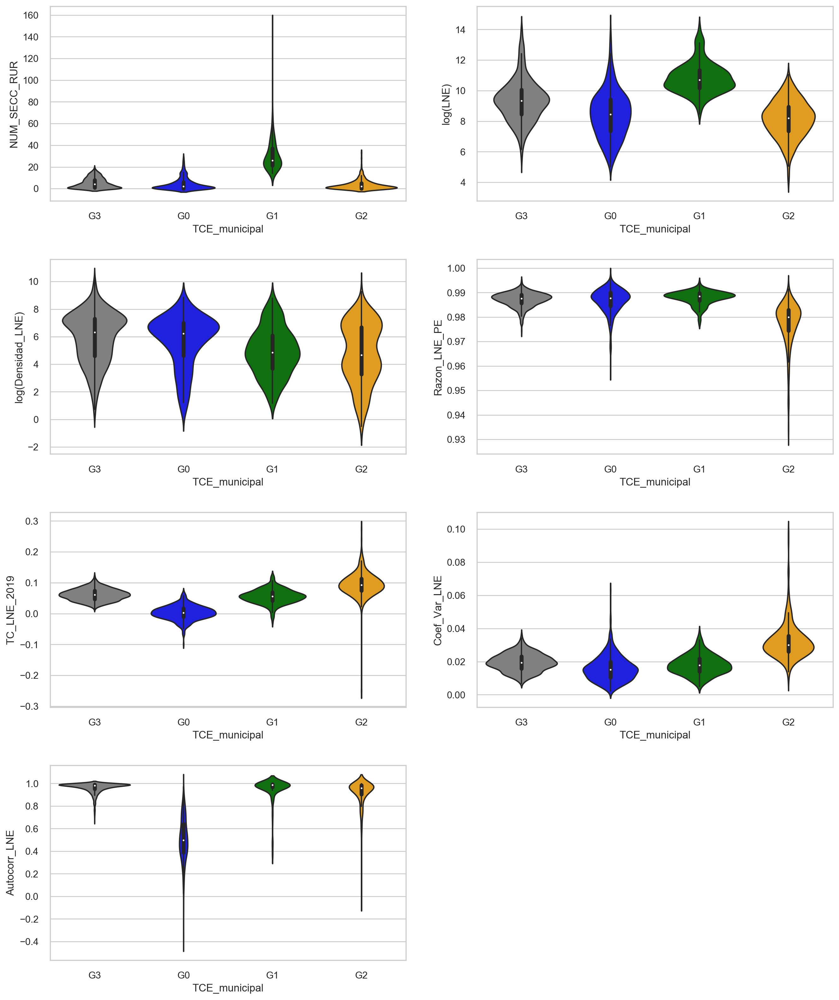

In [60]:
sns.set(style="whitegrid")

fig, axes = plt.subplots(4, 2, figsize=(16, 20), dpi= 200)
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["log(LNE)"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["log(Densidad_LNE)"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind7_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind7_tf["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])

fig.delaxes(axes[3][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical

#se guarda la gráfica
plt.savefig('Pyplot_violin-plot-grid_TCE_ind7_tf.png',dpi=600)
plt.show()


### Identificación de los valores/municipios atípicos (7 indicadores con transformación log)
Etiquetamos los municipios considerados como atípicos en los ICE (considerando la separación por grupos de la tipología, y utilizando la regla intercuartil):

In [63]:
def IQsR_clusters(x):
    x_0 = x['TCE_municipal'] == 'G0'
    x_g0 = x[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    return IQR_pc1_g0+IQR_pc1_g0;

In [64]:
IQsR_clusters(df_indi_pca_kmeans_ind7_tf)

1.7331461127506986

Función para calcular el Q1, Q3 e IQR (calculado por grupos de cluster_Kmeans), y posteriormente clasificar los municipios en tipicos o atipicos en el ICE principal, en el segundo ICE, o en el tercer ICE:

In [65]:
def IQR_clusters_tf(x):
    x_0 = df_indi_pca_kmeans_ind7_tf['TCE_municipal'] == 'G0'
    x_g0 = df_indi_pca_kmeans_ind7_tf[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    
    x_1 = df_indi_pca_kmeans_ind7_tf['TCE_municipal'] == 'G1'
    x_g1 = df_indi_pca_kmeans_ind7_tf[x_1]
    Q1_g1 = x_g1['CP1 (ICE principal)'].quantile(0.25)
    Q3_g1 = x_g1['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g1 = Q3_g1 - Q1_g1
    Q1_pc2_g1 =  x_g1['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g1 = x_g1['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g1 = Q3_pc2_g1 - Q1_pc2_g1
    Q1_pc3_g1 =  x_g1['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g1 = x_g1['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g1 = Q3_pc3_g1 - Q1_pc3_g1
    
    x_2 = df_indi_pca_kmeans_ind7_tf['TCE_municipal'] == 'G2'
    x_g2 = df_indi_pca_kmeans_ind7_tf[x_2]
    Q1_g2 = x_g2['CP1 (ICE principal)'].quantile(0.25)
    Q3_g2 = x_g2['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g2 = Q3_g2 - Q1_g2
    Q1_pc2_g2 =  x_g2['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g2 = x_g2['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g2 = Q3_pc2_g2 - Q1_pc2_g2
    Q1_pc3_g2 =  x_g2['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g2 = x_g2['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g2 = Q3_pc3_g2 - Q1_pc3_g2
    
    x_3 = df_indi_pca_kmeans_ind7_tf['TCE_municipal'] == 'G3'
    x_g3 = df_indi_pca_kmeans_ind7_tf[x_3]
    Q1_g3 = x_g3['CP1 (ICE principal)'].quantile(0.25)
    Q3_g3 = x_g3['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g3 = Q3_g3 - Q1_g3
    Q1_pc2_g3 =  x_g3['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g3 = x_g3['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g3 = Q3_pc2_g3 - Q1_pc2_g3
    Q1_pc3_g3 =  x_g3['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g3 = x_g3['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g3 = Q3_pc3_g3 - Q1_pc3_g3
    
#     x_4 = df_indi_pca_kmeans_ind7_tf['TCE_municipal'] == 'G4'
#     x_g4 = df_indi_pca_kmeans_ind7_tf[x_4]
#     Q1_g4 = x_g4['CP1 (ICE principal)'].quantile(0.25)
#     Q3_g4 = x_g4['CP1 (ICE principal)'].quantile(0.75)
#     IQR_pc1_g4 = Q3_g4 - Q1_g4
#     Q1_pc2_g4 =  x_g4['CP2 (segundo ICE)'].quantile(0.25)
#     Q3_pc2_g4 = x_g4['CP2 (segundo ICE)'].quantile(0.75)
#     IQR_pc2_g4 = Q3_pc2_g4 - Q1_pc2_g4
#     Q1_pc3_g4 =  x_g4['CP3 (tercer ICE)'].quantile(0.25)
#     Q3_pc3_g4 = x_g4['CP3 (tercer ICE)'].quantile(0.75)
#     IQR_pc3_g4 = Q3_pc3_g4 - Q1_pc3_g4
    
#     x_5 = df_indi_pca_kmeans_ind7_tf['TCE_municipal'] == 'G5'
#     x_g5 = df_indi_pca_kmeans_ind7_tf[x_5]
#     Q1_g5 = x_g5['CP1 (ICE principal)'].quantile(0.25)
#     Q3_g5 = x_g5['CP1 (ICE principal)'].quantile(0.75)
#     IQR_pc1_g5 = Q3_g5 - Q1_g5
#     Q1_pc2_g5 =  x_g5['CP2 (segundo ICE)'].quantile(0.25)
#     Q3_pc2_g5 = x_g5['CP2 (segundo ICE)'].quantile(0.75)
#     IQR_pc2_g5 = Q3_pc2_g5 - Q1_pc2_g5
#     Q1_pc3_g5 =  x_g5['CP3 (tercer ICE)'].quantile(0.25)
#     Q3_pc3_g5 = x_g5['CP3 (tercer ICE)'].quantile(0.75)
#     IQR_pc3_g5 = Q3_pc3_g5 - Q1_pc3_g5
    
    if (x['TCE_municipal'] == 'G0'):
        if (x['CP1 (ICE principal)'] < Q1_g0-1.5*IQR_pc1_g0) or (x['CP1 (ICE principal)'] > Q3_g0+1.5*IQR_pc1_g0):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g0-1.5*IQR_pc2_g0) or (x['CP2 (segundo ICE)'] > Q3_pc2_g0+1.5*IQR_pc2_g0):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g0-1.5*IQR_pc3_g0) or (x['CP3 (tercer ICE)'] > Q3_pc3_g0+1.5*IQR_pc3_g0):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G1'):
        if (x['CP1 (ICE principal)'] < Q1_g1-1.5*IQR_pc1_g1) or (x['CP1 (ICE principal)'] > Q3_g1+1.5*IQR_pc1_g1):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g1-1.5*IQR_pc2_g1) or (x['CP2 (segundo ICE)'] > Q3_pc2_g1+1.5*IQR_pc2_g1):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g1-1.5*IQR_pc3_g1) or (x['CP3 (tercer ICE)'] > Q3_pc3_g1+1.5*IQR_pc3_g1):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G2'):
        if (x['CP1 (ICE principal)'] < Q1_g2-1.5*IQR_pc1_g2) or (x['CP1 (ICE principal)'] > Q3_g2+1.5*IQR_pc1_g2):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g2-1.5*IQR_pc2_g2) or (x['CP2 (segundo ICE)'] > Q3_pc2_g2+1.5*IQR_pc2_g2):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g2-1.5*IQR_pc3_g2) or (x['CP3 (tercer ICE)'] > Q3_pc3_g2+1.5*IQR_pc3_g2):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G3'):
        if (x['CP1 (ICE principal)'] < Q1_g3-1.5*IQR_pc1_g3) or (x['CP1 (ICE principal)'] > Q3_g3+1.5*IQR_pc1_g3):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g3-1.5*IQR_pc2_g3) or (x['CP2 (segundo ICE)'] > Q3_pc2_g3+1.5*IQR_pc2_g3):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g3-1.5*IQR_pc3_g3) or (x['CP3 (tercer ICE)'] > Q3_pc3_g3+1.5*IQR_pc3_g3):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
#     elif (x['TCE_municipal'] == 'G4'):
#         if (x['CP1 (ICE principal)'] < Q1_g4-1.5*IQR_pc1_g4) or (x['CP1 (ICE principal)'] > Q3_g4+1.5*IQR_pc1_g4):
#             return 'Atípica en ICE principal'
#         elif (x['CP2 (segundo ICE)'] < Q1_pc2_g4-1.5*IQR_pc2_g4) or (x['CP2 (segundo ICE)'] > Q3_pc2_g4+1.5*IQR_pc2_g4):
#             return 'Atípica en segundo ICE'
#         elif (x['CP3 (tercer ICE)'] < Q1_pc3_g4-1.5*IQR_pc3_g4) or (x['CP3 (tercer ICE)'] > Q3_pc3_g4+1.5*IQR_pc3_g4):
#             return 'Atípica en tercer ICE'
#         else:
#             return 'Tipica'
#     elif (x['TCE_municipal'] == 'G5'):
#         if (x['CP1 (ICE principal)'] < Q1_g5-1.5*IQR_pc1_g5) or (x['CP1 (ICE principal)'] > Q3_g5+1.5*IQR_pc1_g5):
#             return 'Atípica en ICE principal'
#         elif (x['CP2 (segundo ICE)'] < Q1_pc2_g5-1.5*IQR_pc2_g5) or (x['CP2 (segundo ICE)'] > Q3_pc2_g5+1.5*IQR_pc2_g5):
#             return 'Atípica en segundo ICE'
#         elif (x['CP3 (tercer ICE)'] < Q1_pc3_g5-1.5*IQR_pc3_g5) or (x['CP3 (tercer ICE)'] > Q3_pc3_g5+1.5*IQR_pc3_g5):
#             return 'Atípica en tercer ICE'
#         else:
#             return 'Tipica'
    else:
        return 'nan'

In [66]:
#se aplica la función al último df con los resultados:
df_indi_pca_kmeans_ind7_tf['Atipicidad'] = df_indi_pca_kmeans_ind7_tf.apply(IQR_clusters_tf, axis = 1)

#se muestra el dataframe:
df_indi_pca_kmeans_ind7_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,log(LNE),log(Densidad_LNE),Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,10.460729,8.179207,0.989272,0.037498,0.015085,...,0.755939,-0.995331,0.745533,-1.389633,0.434649,0.105639,-0.259502,-0.196240,G3,Tipica
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,8.841304,3.838256,0.991803,0.000289,0.008345,...,0.237061,-3.318903,-0.619987,0.723898,0.193995,-0.969311,-0.651817,-1.034857,G0,Tipica
2,1,AGUASCALIENTES,9,TEPEZALA,6,9.651494,7.815480,0.990635,0.005108,0.011777,...,0.344567,-2.757468,0.081456,-0.908153,1.115722,-0.558179,-0.004696,-0.705979,G0,Tipica
3,1,AGUASCALIENTES,11,EL LLANO,6,9.620262,7.317046,0.991016,-0.003373,0.012239,...,0.504020,-2.523745,0.260810,-0.738536,0.676101,-0.383889,-0.048412,-0.126217,G0,Tipica
4,1,AGUASCALIENTES,2,ASIENTOS,11,10.440624,7.302983,0.989080,0.001874,0.013432,...,0.374738,-2.490247,0.453746,-0.450692,1.507864,-0.496284,-0.207700,-0.497406,G0,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,13,8.847791,3.595632,0.983523,0.066677,0.019408,...,0.959378,0.566375,-0.038837,1.137560,-0.402981,0.304617,0.000411,-0.066702,G3,Tipica
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,9.762615,2.680698,0.986450,0.082705,0.022769,...,0.984897,1.080969,1.300230,2.208190,-0.057168,-0.342807,0.496959,-0.236424,G1,Tipica
2455,32,ZACATECAS,44,TABASCO,16,9.435642,3.973022,0.983221,0.100307,0.029823,...,0.993335,1.911600,0.178614,0.950089,0.065079,-0.393423,0.058249,-0.192537,G2,Tipica
2456,32,ZACATECAS,9,CHALCHIHUITES,10,9.014569,6.396658,0.982861,0.075052,0.021097,...,0.988608,0.851114,0.072100,-0.200368,0.061119,0.545074,0.389442,-0.072882,G3,Tipica


In [67]:
#para verificar, imprimimos los valores únicos en la columna Atipicidad.
df_indi_pca_kmeans_ind7_tf.Atipicidad.unique()

array(['Tipica', 'Atípica en segundo ICE', 'Atípica en ICE principal',
       'Atípica en tercer ICE'], dtype=object)

In [68]:
#imprimimos la frecuencia de los valores únicos en Atipicidad
df_indi_pca_kmeans_ind7_tf['Atipicidad'].value_counts()

Tipica                      2377
Atípica en ICE principal      43
Atípica en segundo ICE        27
Atípica en tercer ICE         11
Name: Atipicidad, dtype: int64

In [69]:
#imprimimos el número de municipios por grupo de la tipología.
df_indi_pca_kmeans_ind7_tf['TCE_municipal'].value_counts()

G3    1313
G0     525
G2     338
G1     282
Name: TCE_municipal, dtype: int64

In [70]:
#se guardan los resultados en un csv
df_indi_pca_kmeans_ind7_tf.to_csv(r'Resultados_Mun_Indic_PCA_Kmeans_Atip_ind7_tf.csv', index = None)


## Escenario 3: (8 indicadores)

In [71]:
#unimos los resultados de PCA_Kmeans con los metadatos y los 8 indicadores de los municipios
df_indi_pca_kmeans_ind8=pd.merge(datos_mun_limpio, df_pca_results_ind8_kmeans, on=['EDO','NOMBRE_ESTADO','MUN','NOMBRE_MUNICIPIO'], how='inner')

#renombramos algunas columnas_pca
df_indi_pca_kmeans_ind8=df_indi_pca_kmeans_ind8.rename(columns={"CP1": "CP1 (ICE principal)", "CP2": "CP2 (segundo ICE)", "CP3": "CP3 (tercer ICE)"})

df_indi_pca_kmeans_ind8

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34917.0,3566.024547,0.989272,0.037498,0.015085,...,0.755939,-1.212730,0.714345,0.923540,-0.603382,-0.084640,-0.782450,-0.261916,-0.003056,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,6914.0,46.444421,0.991803,0.000289,0.008345,...,0.237061,-3.406688,-1.362798,0.754667,0.415810,-0.885600,0.272844,-1.093298,0.029088,G0
2,1,AGUASCALIENTES,9,TEPEZALA,6,15545.0,2478.675412,0.990635,0.005108,0.011777,...,0.344567,-2.795431,-0.391567,1.266848,0.337623,-0.693461,-0.657287,-0.864759,0.099806,G0
3,1,AGUASCALIENTES,11,EL LLANO,6,15067.0,1505.749552,0.991016,-0.003373,0.012239,...,0.504020,-2.524197,-0.487015,0.724376,0.172457,-0.717782,-0.340382,-0.187773,-0.019983,G0
4,1,AGUASCALIENTES,2,ASIENTOS,11,34222.0,1484.722551,0.989080,0.001874,0.013432,...,0.374738,-2.419575,-0.569647,0.875752,0.915294,-0.718031,-0.391693,-0.592203,-0.023749,G0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,13,6959.0,36.438707,0.983523,0.066677,0.019408,...,0.959378,0.293567,-0.246173,-0.802060,0.124052,0.581356,0.047280,-0.025936,0.065240,G1
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,17372.0,14.595272,0.986450,0.082705,0.022769,...,0.984897,0.752369,0.392485,-1.955040,1.087186,-0.002043,-0.540422,-0.324093,0.042029,G3
2455,32,ZACATECAS,44,TABASCO,16,12527.0,53.144872,0.983221,0.100307,0.029823,...,0.993335,2.209573,-0.054915,-0.842182,0.460205,-0.155634,-0.075444,-0.244536,-0.061517,G2
2456,32,ZACATECAS,9,CHALCHIHUITES,10,8222.0,599.837116,0.982861,0.075052,0.021097,...,0.988608,0.749358,-0.079880,-0.495159,-0.084159,0.593947,-0.049198,-0.034575,-0.001863,G1



### Gráficas (pair-plot, box-plots, violin-plots)

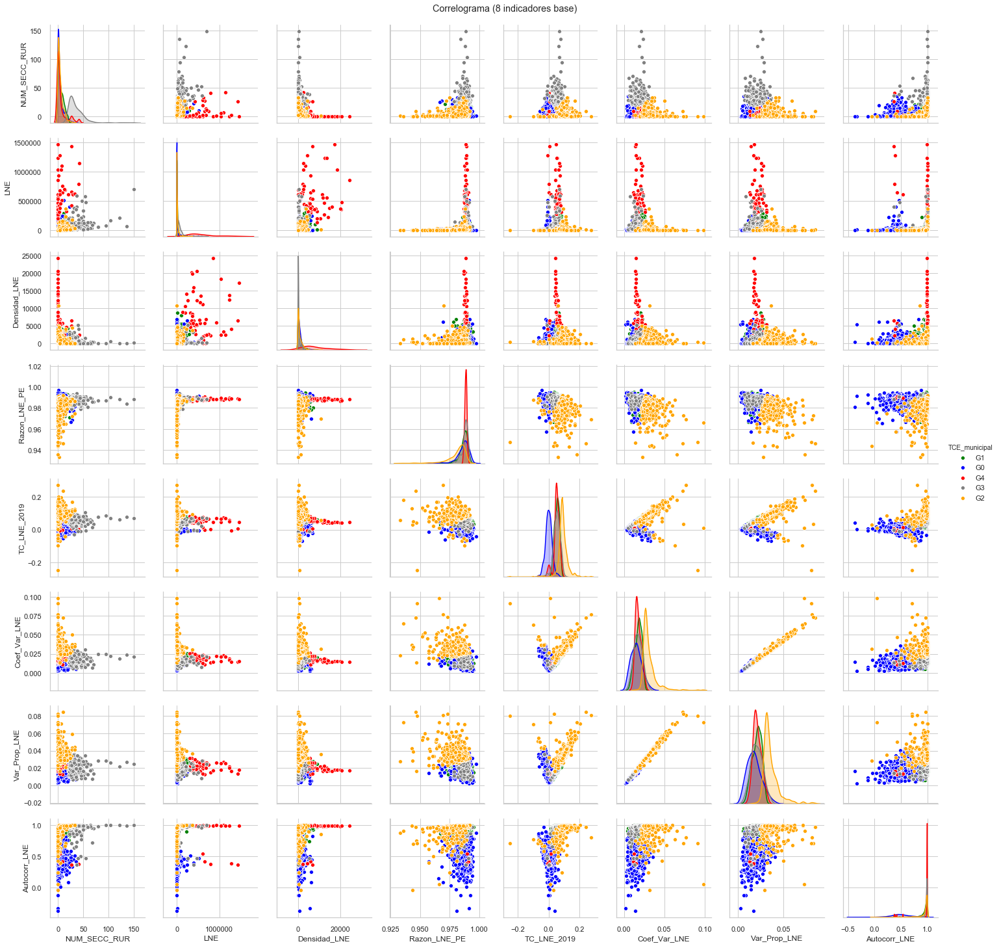

In [72]:
#sólo tomamos los indicadores y grupos
df_indi_pca_kmeans_ind8_f = df_indi_pca_kmeans_ind8[['NUM_SECC_RUR','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'TCE_municipal']]
#pair-plot (colores en funcion de grupo)
corr4=sns.pairplot(df_indi_pca_kmeans_ind8_f, 
                   hue="TCE_municipal",
                   palette=color_dict)
corr4.fig.suptitle("Correlograma (8 indicadores base)", y=1.01)
#guardar la pair-plot
corr4.savefig('Pyplot_correlogram_TCE_ind8.png',dpi=600)

Plotgrid de gráficas de caja para cada indicador e índice de complejidad electoral (por grupo)

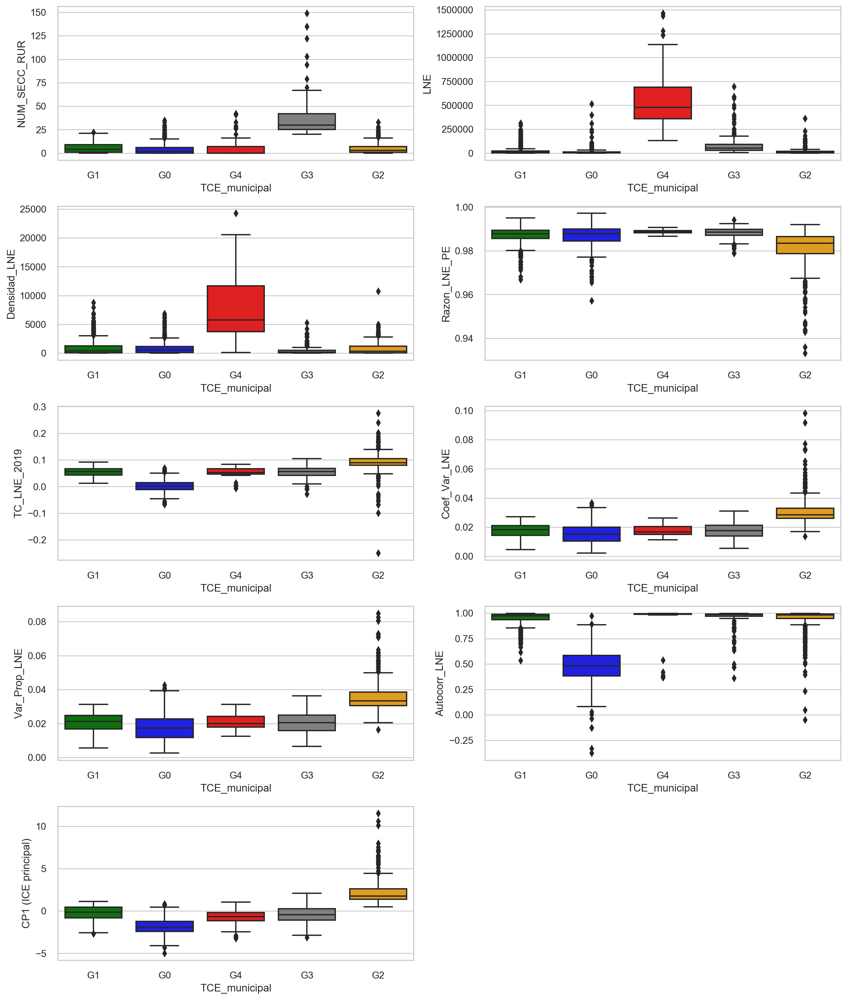

In [73]:
sns.set(style="whitegrid")
fig, axes = plt.subplots(5, 2, figsize=(16, 20), dpi= 200)

ax = sns.boxplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["LNE"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["Densidad_LNE"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["Var_Prop_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["CP1 (ICE principal)"], palette=color_dict, orient='v', 
    ax=axes[4, 0])

fig.delaxes(axes[4][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical
#se guarda la gráfica
plt.savefig('Pyplot_box-plots-grid_TCE_ind8.png',dpi=600)
plt.show()

Gráfica de violín (por grupos, para el indicador "CP1")

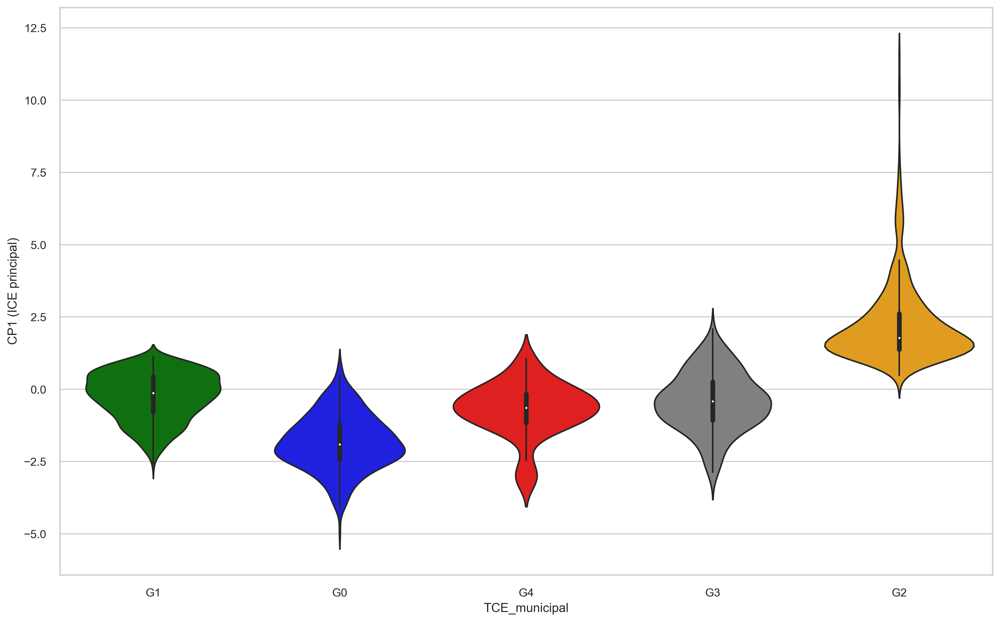

In [74]:
plt.figure(figsize=(16, 10), dpi= 300, facecolor='w', edgecolor='k')
sns.violinplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["CP1 (ICE principal)"], palette=color_dict);
#se guarda la gráfica
plt.savefig('Pyplot_violin_TCE_ind8.png',dpi=600)
plt.show()

Plotgrid de gráficas de violín para cada indicador e índice de complejidad electoral (por grupo)

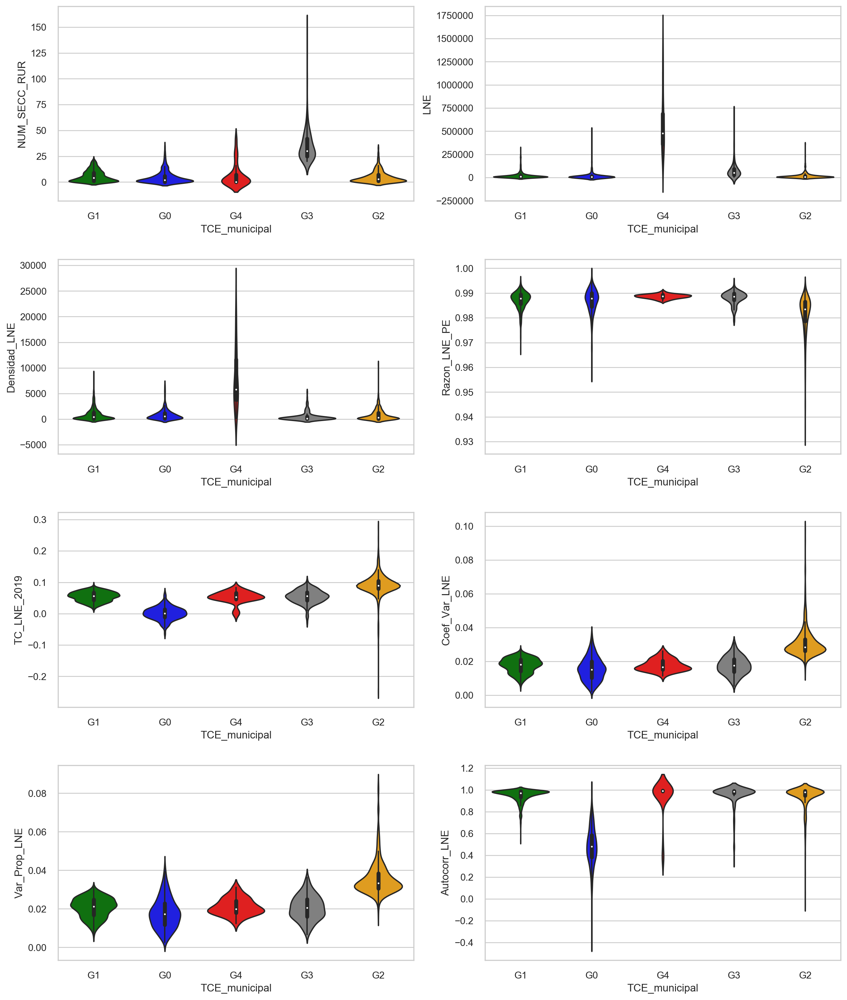

In [75]:
sns.set(style="whitegrid")

fig, axes = plt.subplots(4, 2, figsize=(16, 20), dpi= 200)
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["LNE"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["Densidad_LNE"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["Var_Prop_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8["TCE_municipal"], y=df_indi_pca_kmeans_ind8["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 1])

#fig.delaxes(axes[5][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical

#se guarda la gráfica
plt.savefig('Pyplot_violin-plot-grid_TCE_ind8.png',dpi=600)
plt.show()


### Identificación de los valores/municipios atípicos (8 indicadores)
Etiquetamos los municipios considerados como atípicos en los ICE (considerando la separación por grupos de la tipología, y utilizando la regla intercuartil):

In [76]:
#ejemplo:
df_indi_pca_kmeans_ind8['CP1 (ICE principal)'].quantile(0.25)

-1.152718101108954

In [77]:
def IQsR_clusters(x):
    x_0 = x['TCE_municipal'] == 'G0'
    x_g0 = x[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    return IQR_pc1_g0+IQR_pc1_g0;

In [78]:
IQsR_clusters(df_indi_pca_kmeans_ind8)

2.415944456266859

Función para calcular el Q1, Q3 e IQR (calculado por grupos de cluster_Kmeans), y posteriormente clasificar los municipios en tipicos o atipicos en el ICE principal.

In [79]:
def IQR_clusters(x):
    x_0 = df_indi_pca_kmeans_ind8['TCE_municipal'] == 'G0'
    x_g0 = df_indi_pca_kmeans_ind8[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    
    x_1 = df_indi_pca_kmeans_ind8['TCE_municipal'] == 'G1'
    x_g1 = df_indi_pca_kmeans_ind8[x_1]
    Q1_g1 = x_g1['CP1 (ICE principal)'].quantile(0.25)
    Q3_g1 = x_g1['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g1 = Q3_g1 - Q1_g1
    Q1_pc2_g1 =  x_g1['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g1 = x_g1['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g1 = Q3_pc2_g1 - Q1_pc2_g1
    Q1_pc3_g1 =  x_g1['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g1 = x_g1['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g1 = Q3_pc3_g1 - Q1_pc3_g1
    
    x_2 = df_indi_pca_kmeans_ind8['TCE_municipal'] == 'G2'
    x_g2 = df_indi_pca_kmeans_ind8[x_2]
    Q1_g2 = x_g2['CP1 (ICE principal)'].quantile(0.25)
    Q3_g2 = x_g2['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g2 = Q3_g2 - Q1_g2
    Q1_pc2_g2 =  x_g2['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g2 = x_g2['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g2 = Q3_pc2_g2 - Q1_pc2_g2
    Q1_pc3_g2 =  x_g2['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g2 = x_g2['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g2 = Q3_pc3_g2 - Q1_pc3_g2
    
    x_3 = df_indi_pca_kmeans_ind8['TCE_municipal'] == 'G3'
    x_g3 = df_indi_pca_kmeans_ind8[x_3]
    Q1_g3 = x_g3['CP1 (ICE principal)'].quantile(0.25)
    Q3_g3 = x_g3['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g3 = Q3_g3 - Q1_g3
    Q1_pc2_g3 =  x_g3['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g3 = x_g3['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g3 = Q3_pc2_g3 - Q1_pc2_g3
    Q1_pc3_g3 =  x_g3['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g3 = x_g3['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g3 = Q3_pc3_g3 - Q1_pc3_g3
    
    
    x_4 = df_indi_pca_kmeans_ind8['TCE_municipal'] == 'G4'
    x_g4 = df_indi_pca_kmeans_ind8[x_4]
    Q1_g4 = x_g4['CP1 (ICE principal)'].quantile(0.25)
    Q3_g4 = x_g4['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g4 = Q3_g4 - Q1_g4
    Q1_pc2_g4 =  x_g4['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g4 = x_g4['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g4 = Q3_pc2_g4 - Q1_pc2_g4
    Q1_pc3_g4 =  x_g4['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g4 = x_g4['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g4 = Q3_pc3_g4 - Q1_pc3_g4
    
#     x_5 = df_indi_pca_kmeans_ind8['TCE_municipal'] == 'G5'
#     x_g5 = df_indi_pca_kmeans_ind8[x_5]
#     Q1_g5 = x_g5['CP1 (ICE principal)'].quantile(0.25)
#     Q3_g5 = x_g5['CP1 (ICE principal)'].quantile(0.75)
#     IQR_pc1_g5 = Q3_g5 - Q1_g5
#     Q1_pc2_g5 =  x_g5['CP2 (segundo ICE)'].quantile(0.25)
#     Q3_pc2_g5 = x_g5['CP2 (segundo ICE)'].quantile(0.75)
#     IQR_pc2_g5 = Q3_pc2_g5 - Q1_pc2_g5
#     Q1_pc3_g5 =  x_g5['CP3 (tercer ICE)'].quantile(0.25)
#     Q3_pc3_g5 = x_g5['CP3 (tercer ICE)'].quantile(0.75)
#     IQR_pc3_g5 = Q3_pc3_g5 - Q1_pc3_g5
    
    if (x['TCE_municipal'] == 'G0'):
        if (x['CP1 (ICE principal)'] < Q1_g0-1.5*IQR_pc1_g0) or (x['CP1 (ICE principal)'] > Q3_g0+1.5*IQR_pc1_g0):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g0-1.5*IQR_pc2_g0) or (x['CP2 (segundo ICE)'] > Q3_pc2_g0+1.5*IQR_pc2_g0):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g0-1.5*IQR_pc3_g0) or (x['CP3 (tercer ICE)'] > Q3_pc3_g0+1.5*IQR_pc3_g0):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G1'):
        if (x['CP1 (ICE principal)'] < Q1_g1-1.5*IQR_pc1_g1) or (x['CP1 (ICE principal)'] > Q3_g1+1.5*IQR_pc1_g1):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g1-1.5*IQR_pc2_g1) or (x['CP2 (segundo ICE)'] > Q3_pc2_g1+1.5*IQR_pc2_g1):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g1-1.5*IQR_pc3_g1) or (x['CP3 (tercer ICE)'] > Q3_pc3_g1+1.5*IQR_pc3_g1):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G2'):
        if (x['CP1 (ICE principal)'] < Q1_g2-1.5*IQR_pc1_g2) or (x['CP1 (ICE principal)'] > Q3_g2+1.5*IQR_pc1_g2):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g2-1.5*IQR_pc2_g2) or (x['CP2 (segundo ICE)'] > Q3_pc2_g2+1.5*IQR_pc2_g2):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g2-1.5*IQR_pc3_g2) or (x['CP3 (tercer ICE)'] > Q3_pc3_g2+1.5*IQR_pc3_g2):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G3'):
        if (x['CP1 (ICE principal)'] < Q1_g3-1.5*IQR_pc1_g3) or (x['CP1 (ICE principal)'] > Q3_g3+1.5*IQR_pc1_g3):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g3-1.5*IQR_pc2_g3) or (x['CP2 (segundo ICE)'] > Q3_pc2_g3+1.5*IQR_pc2_g3):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g3-1.5*IQR_pc3_g3) or (x['CP3 (tercer ICE)'] > Q3_pc3_g3+1.5*IQR_pc3_g3):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G4'):
        if (x['CP1 (ICE principal)'] < Q1_g4-1.5*IQR_pc1_g4) or (x['CP1 (ICE principal)'] > Q3_g4+1.5*IQR_pc1_g4):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g4-1.5*IQR_pc2_g4) or (x['CP2 (segundo ICE)'] > Q3_pc2_g4+1.5*IQR_pc2_g4):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g4-1.5*IQR_pc3_g4) or (x['CP3 (tercer ICE)'] > Q3_pc3_g4+1.5*IQR_pc3_g4):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
#     elif (x['TCE_municipal'] == 'G5'):
#         if (x['CP1 (ICE principal)'] < Q1_g5-1.5*IQR_pc1_g5) or (x['CP1 (ICE principal)'] > Q3_g5+1.5*IQR_pc1_g5):
#             return 'Atípica en ICE principal'
#         elif (x['CP2 (segundo ICE)'] < Q1_pc2_g5-1.5*IQR_pc2_g5) or (x['CP2 (segundo ICE)'] > Q3_pc2_g5+1.5*IQR_pc2_g5):
#             return 'Atípica en segundo ICE'
#         elif (x['CP3 (tercer ICE)'] < Q1_pc3_g5-1.5*IQR_pc3_g5) or (x['CP3 (tercer ICE)'] > Q3_pc3_g5+1.5*IQR_pc3_g5):
#             return 'Atípica en tercer ICE'
#         else:
#             return 'Tipica'
    else:
        return 'nan'

In [80]:
#se aplica la función al último df con los resultados:
df_indi_pca_kmeans_ind8['Atipicidad'] = df_indi_pca_kmeans_ind8.apply(IQR_clusters, axis = 1)

#se muestra el dataframe:
df_indi_pca_kmeans_ind8

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,LNE,Densidad_LNE,Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,34917.0,3566.024547,0.989272,0.037498,0.015085,...,-1.212730,0.714345,0.923540,-0.603382,-0.084640,-0.782450,-0.261916,-0.003056,G1,Tipica
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,6914.0,46.444421,0.991803,0.000289,0.008345,...,-3.406688,-1.362798,0.754667,0.415810,-0.885600,0.272844,-1.093298,0.029088,G0,Tipica
2,1,AGUASCALIENTES,9,TEPEZALA,6,15545.0,2478.675412,0.990635,0.005108,0.011777,...,-2.795431,-0.391567,1.266848,0.337623,-0.693461,-0.657287,-0.864759,0.099806,G0,Tipica
3,1,AGUASCALIENTES,11,EL LLANO,6,15067.0,1505.749552,0.991016,-0.003373,0.012239,...,-2.524197,-0.487015,0.724376,0.172457,-0.717782,-0.340382,-0.187773,-0.019983,G0,Tipica
4,1,AGUASCALIENTES,2,ASIENTOS,11,34222.0,1484.722551,0.989080,0.001874,0.013432,...,-2.419575,-0.569647,0.875752,0.915294,-0.718031,-0.391693,-0.592203,-0.023749,G0,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,13,6959.0,36.438707,0.983523,0.066677,0.019408,...,0.293567,-0.246173,-0.802060,0.124052,0.581356,0.047280,-0.025936,0.065240,G1,Tipica
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,17372.0,14.595272,0.986450,0.082705,0.022769,...,0.752369,0.392485,-1.955040,1.087186,-0.002043,-0.540422,-0.324093,0.042029,G3,Tipica
2455,32,ZACATECAS,44,TABASCO,16,12527.0,53.144872,0.983221,0.100307,0.029823,...,2.209573,-0.054915,-0.842182,0.460205,-0.155634,-0.075444,-0.244536,-0.061517,G2,Tipica
2456,32,ZACATECAS,9,CHALCHIHUITES,10,8222.0,599.837116,0.982861,0.075052,0.021097,...,0.749358,-0.079880,-0.495159,-0.084159,0.593947,-0.049198,-0.034575,-0.001863,G1,Tipica


In [81]:
#para verificar, imprimimos los valores únicos en la columna Atipicidad.
df_indi_pca_kmeans_ind8.Atipicidad.unique()

array(['Tipica', 'Atípica en segundo ICE', 'Atípica en ICE principal',
       'Atípica en tercer ICE'], dtype=object)

In [82]:
#imprimimos la frecuencia de los valores únicos en Atipicidad
df_indi_pca_kmeans_ind8['Atipicidad'].value_counts()

Tipica                      2239
Atípica en segundo ICE       151
Atípica en ICE principal      46
Atípica en tercer ICE         22
Name: Atipicidad, dtype: int64

In [83]:
#imprimimos el número de municipios por grupo de la tipología.
df_indi_pca_kmeans_ind8['TCE_municipal'].value_counts()

G1    1161
G2     569
G0     478
G3     193
G4      57
Name: TCE_municipal, dtype: int64

In [84]:
#se guardan los resultados en un csv
df_indi_pca_kmeans_ind8.to_csv(r'Resultados_Mun_Indic_PCA_Kmeans_Atip_ind8.csv', index = None)

<br>

## Escenario 4: 8 indicadores (con transformación log en LNE y Densidad_LNE)

In [85]:
#unimos los resultados de PCA_Kmeans con los metadatos y los 8 indicadores de los municipios
df_indi_pca_kmeans_ind8_tf=pd.merge(datos_mun_limpio_tf, df_pca_results_ind8_tf_kmeans, on=['EDO','NOMBRE_ESTADO','MUN','NOMBRE_MUNICIPIO'], how='inner')

#renombramos algunas columnas_pca
df_indi_pca_kmeans_ind8_tf=df_indi_pca_kmeans_ind8_tf.rename(columns={"CP1": "CP1 (ICE principal)", 
                                                            "CP2": "CP2 (segundo ICE)", 
                                                            "CP3": "CP3 (tercer ICE)",
                                                           "LNE": "log(LNE)",
                                                           "Densidad_LNE": "log(Densidad_LNE)"})

df_indi_pca_kmeans_ind8_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,log(LNE),log(Densidad_LNE),Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,10.460729,8.179207,0.989272,0.037498,0.015085,...,0.755939,-1.214070,0.513032,-1.450945,0.431519,0.182643,-0.259314,-0.187243,0.010094,G1
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,8.841304,3.838256,0.991803,0.000289,0.008345,...,0.237061,-3.422301,-1.284015,0.577059,0.648052,-0.969611,-0.638014,-1.147983,0.037785,G2
2,1,AGUASCALIENTES,9,TEPEZALA,6,9.651494,7.815480,0.990635,0.005108,0.011777,...,0.344567,-2.820073,-0.517094,-1.072523,1.362320,-0.340752,0.004996,-0.799488,0.107345,G2
3,1,AGUASCALIENTES,11,EL LLANO,6,9.620262,7.317046,0.991016,-0.003373,0.012239,...,0.504020,-2.557359,-0.295472,-0.890254,0.975709,-0.418065,-0.044813,-0.157649,-0.013624,G2
4,1,AGUASCALIENTES,2,ASIENTOS,11,10.440624,7.302983,0.989080,0.001874,0.013432,...,0.374738,-2.449705,-0.118811,-0.643405,1.811638,-0.307746,-0.200200,-0.563693,-0.009320,G2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,13,8.847791,3.595632,0.983523,0.066677,0.019408,...,0.959378,0.294566,0.126657,1.201204,-0.512943,0.306917,-0.001819,-0.039371,0.061847,G1
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,9.762615,2.680698,0.986450,0.082705,0.022769,...,0.984897,0.770249,1.514170,2.214195,0.063605,-0.312969,0.501606,-0.285044,0.033742,G3
2455,32,ZACATECAS,44,TABASCO,16,9.435642,3.973022,0.983221,0.100307,0.029823,...,0.993335,2.207745,0.543961,0.993419,0.054510,-0.291653,0.063391,-0.248878,-0.062676,G0
2456,32,ZACATECAS,9,CHALCHIHUITES,10,9.014569,6.396658,0.982861,0.075052,0.021097,...,0.988608,0.723186,0.265904,-0.141626,-0.185856,0.667093,0.385281,-0.014308,-0.006761,G1



### Gráficas (pair-plot, box-plots, violin-plots)

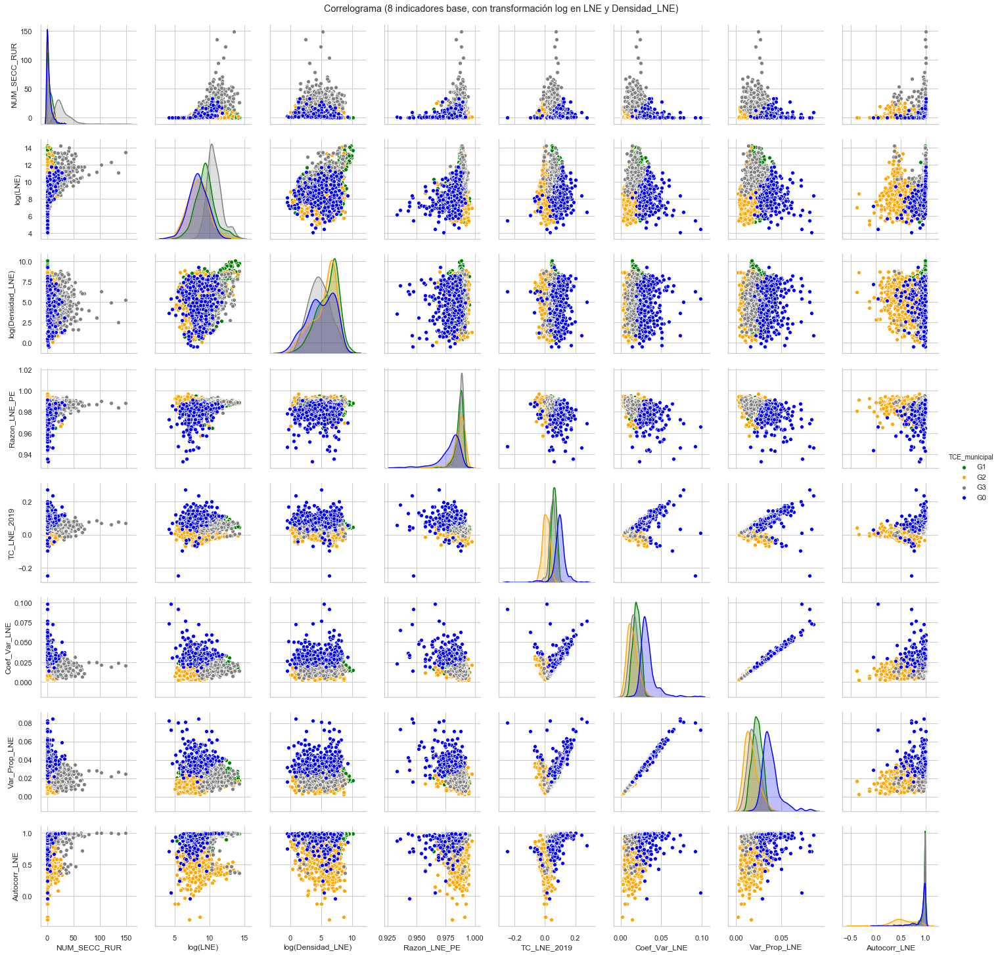

In [86]:
#sólo tomamos los indicadores y grupos
df_indi_pca_kmeans_ind8_tf_f = df_indi_pca_kmeans_ind8_tf[['NUM_SECC_RUR','log(LNE)', 'log(Densidad_LNE)', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'TCE_municipal']]
#pair-plot (colores en funcion de grupo)
corr4_tf=sns.pairplot(df_indi_pca_kmeans_ind8_tf_f, 
                   hue="TCE_municipal",
                   palette=color_dict)
corr4_tf.fig.suptitle("Correlograma (8 indicadores base, con transformación log en LNE y Densidad_LNE)", y=1.01)
#guardar la pair-plot
corr4_tf.savefig('Pyplot_correlogram_TCE_ind8_tf.png',dpi=600)

Plotgrid de gráficas de caja para cada indicador e índice de complejidad electoral (por grupo)

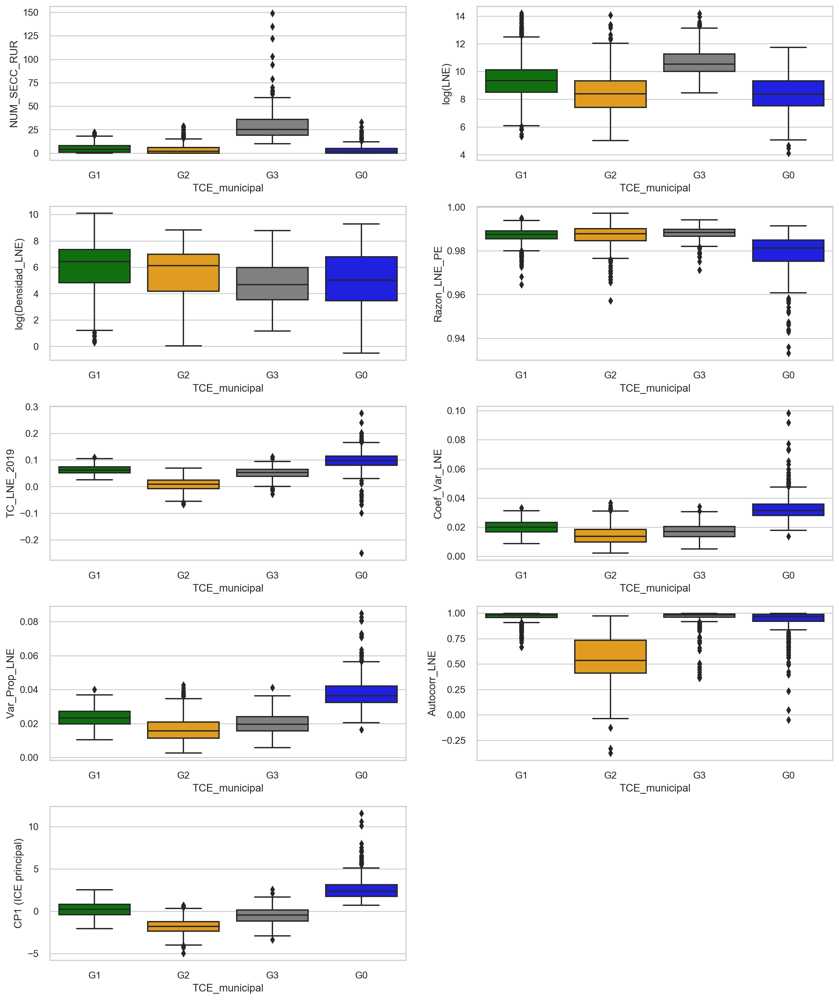

In [87]:
sns.set(style="whitegrid")
fig, axes = plt.subplots(5, 2, figsize=(16, 20), dpi= 200)

ax = sns.boxplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["log(LNE)"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["log(Densidad_LNE)"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["Var_Prop_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 1])
ax = sns.boxplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["CP1 (ICE principal)"], palette=color_dict, orient='v', 
    ax=axes[4, 0])

fig.delaxes(axes[4][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical
#se guarda la gráfica
plt.savefig('Pyplot_box-plots-grid_TCE_ind8_tf.png',dpi=600)
plt.show()

Gráfica de violín (por grupos, para el indicador "CP1")

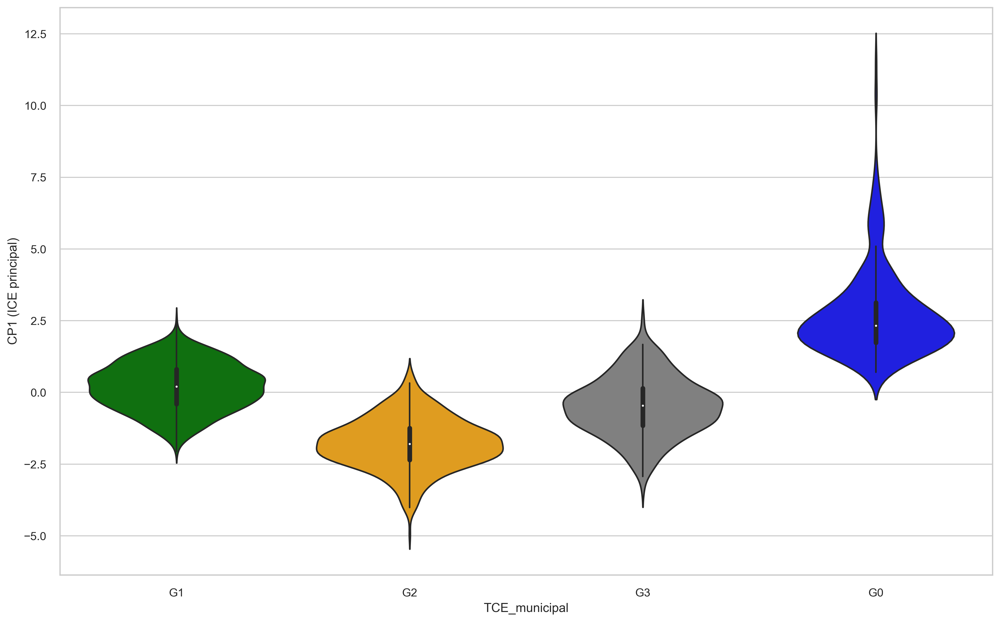

In [88]:
plt.figure(figsize=(16, 10), dpi= 300, facecolor='w', edgecolor='k')
sns.violinplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["CP1 (ICE principal)"], palette=color_dict);
#se guarda la gráfica
plt.savefig('Pyplot_violin_TCE_ind8_tf.png',dpi=600)
plt.show()

Plotgrid de gráficas de violín para cada indicador e índice de complejidad electoral (por grupo)

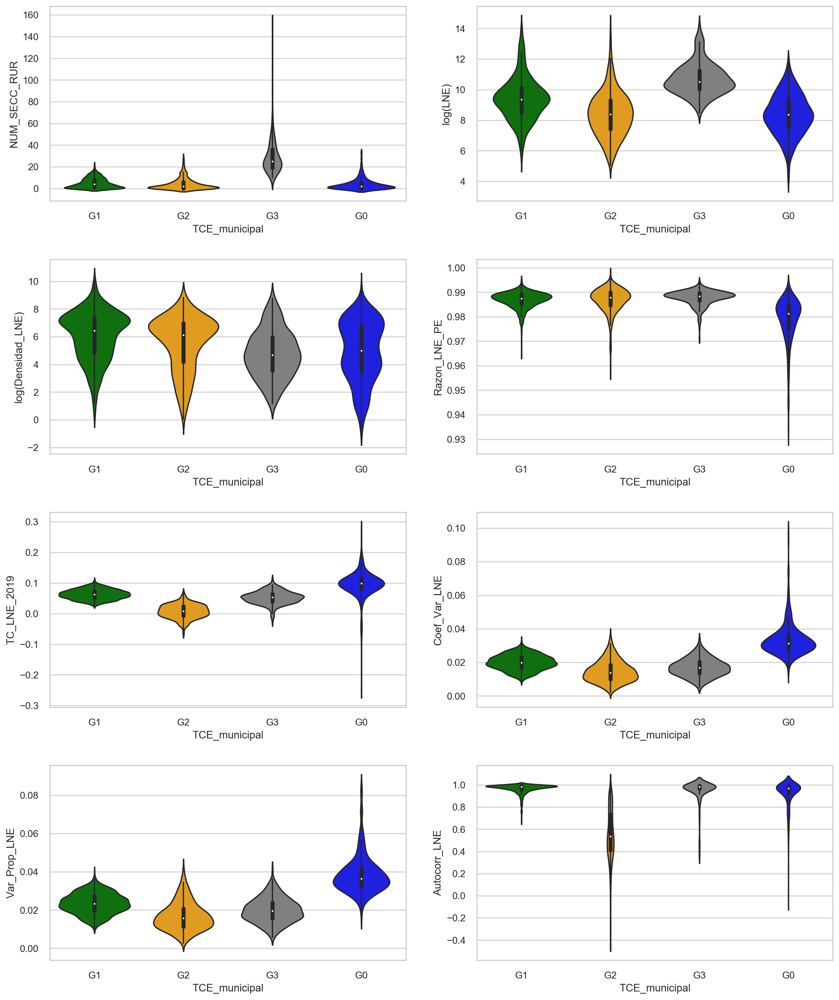

In [89]:
sns.set(style="whitegrid")

fig, axes = plt.subplots(4, 2, figsize=(16, 20), dpi= 200)
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["NUM_SECC_RUR"], palette=color_dict, orient='v', 
    ax=axes[0, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["log(LNE)"], palette=color_dict, orient='v', 
    ax=axes[0, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["log(Densidad_LNE)"], palette=color_dict, orient='v', 
    ax=axes[1, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["Razon_LNE_PE"], palette=color_dict, orient='v', 
    ax=axes[1, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["TC_LNE_2019"], palette=color_dict, orient='v', 
    ax=axes[2, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["Coef_Var_LNE"], palette=color_dict, orient='v', 
    ax=axes[2, 1])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["Var_Prop_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 0])
ax = sns.violinplot(x=df_indi_pca_kmeans_ind8_tf["TCE_municipal"], y=df_indi_pca_kmeans_ind8_tf["Autocorr_LNE"], palette=color_dict, orient='v', 
    ax=axes[3, 1])

#fig.delaxes(axes[5][1]) #borrar subplot sin usar
plt.subplots_adjust(hspace=0.3) #dar mas espacio vertical

#se guarda la gráfica
plt.savefig('Pyplot_violin-plot-grid_TCE_ind8_tf.png',dpi=600)
plt.show()


### Identificación de los valores/municipios atípicos (8 indicadores con transformación log)
Etiquetamos los municipios considerados como atípicos en los ICE (considerando la separación por grupos de la tipología, y utilizando la regla intercuartil):

In [90]:
def IQsR_clusters(x):
    x_0 = x['TCE_municipal'] == 'G0'
    x_g0 = x[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    return IQR_pc1_g0+IQR_pc1_g0;

In [91]:
IQsR_clusters(df_indi_pca_kmeans_ind8_tf)

2.798722203574237

Función para calcular el Q1, Q3 e IQR (calculado por grupos de cluster_Kmeans), y posteriormente clasificar los municipios en tipicos o atipicos en el ICE principal, en el segundo ICE, o en el tercer ICE:

In [92]:
def IQR_clusters_tf(x):
    x_0 = df_indi_pca_kmeans_ind8_tf['TCE_municipal'] == 'G0'
    x_g0 = df_indi_pca_kmeans_ind8_tf[x_0]
    Q1_g0 = x_g0['CP1 (ICE principal)'].quantile(0.25)
    Q3_g0 = x_g0['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g0 = Q3_g0 - Q1_g0
    Q1_pc2_g0 =  x_g0['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g0 = x_g0['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g0 = Q3_pc2_g0 - Q1_pc2_g0
    Q1_pc3_g0 =  x_g0['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g0 = x_g0['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g0 = Q3_pc3_g0 - Q1_pc3_g0
    
    x_1 = df_indi_pca_kmeans_ind8_tf['TCE_municipal'] == 'G1'
    x_g1 = df_indi_pca_kmeans_ind8_tf[x_1]
    Q1_g1 = x_g1['CP1 (ICE principal)'].quantile(0.25)
    Q3_g1 = x_g1['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g1 = Q3_g1 - Q1_g1
    Q1_pc2_g1 =  x_g1['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g1 = x_g1['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g1 = Q3_pc2_g1 - Q1_pc2_g1
    Q1_pc3_g1 =  x_g1['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g1 = x_g1['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g1 = Q3_pc3_g1 - Q1_pc3_g1
    
    x_2 = df_indi_pca_kmeans_ind8_tf['TCE_municipal'] == 'G2'
    x_g2 = df_indi_pca_kmeans_ind8_tf[x_2]
    Q1_g2 = x_g2['CP1 (ICE principal)'].quantile(0.25)
    Q3_g2 = x_g2['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g2 = Q3_g2 - Q1_g2
    Q1_pc2_g2 =  x_g2['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g2 = x_g2['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g2 = Q3_pc2_g2 - Q1_pc2_g2
    Q1_pc3_g2 =  x_g2['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g2 = x_g2['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g2 = Q3_pc3_g2 - Q1_pc3_g2
    
    x_3 = df_indi_pca_kmeans_ind8_tf['TCE_municipal'] == 'G3'
    x_g3 = df_indi_pca_kmeans_ind8_tf[x_3]
    Q1_g3 = x_g3['CP1 (ICE principal)'].quantile(0.25)
    Q3_g3 = x_g3['CP1 (ICE principal)'].quantile(0.75)
    IQR_pc1_g3 = Q3_g3 - Q1_g3
    Q1_pc2_g3 =  x_g3['CP2 (segundo ICE)'].quantile(0.25)
    Q3_pc2_g3 = x_g3['CP2 (segundo ICE)'].quantile(0.75)
    IQR_pc2_g3 = Q3_pc2_g3 - Q1_pc2_g3
    Q1_pc3_g3 =  x_g3['CP3 (tercer ICE)'].quantile(0.25)
    Q3_pc3_g3 = x_g3['CP3 (tercer ICE)'].quantile(0.75)
    IQR_pc3_g3 = Q3_pc3_g3 - Q1_pc3_g3
    
    
#     x_4 = df_indi_pca_kmeans_ind8_tf['TCE_municipal'] == 'G4'
#     x_g4 = df_indi_pca_kmeans_ind8_tf[x_4]
#     Q1_g4 = x_g4['CP1 (ICE principal)'].quantile(0.25)
#     Q3_g4 = x_g4['CP1 (ICE principal)'].quantile(0.75)
#     IQR_pc1_g4 = Q3_g4 - Q1_g4
#     Q1_pc2_g4 =  x_g4['CP2 (segundo ICE)'].quantile(0.25)
#     Q3_pc2_g4 = x_g4['CP2 (segundo ICE)'].quantile(0.75)
#     IQR_pc2_g4 = Q3_pc2_g4 - Q1_pc2_g4
#     Q1_pc3_g4 =  x_g4['CP3 (tercer ICE)'].quantile(0.25)
#     Q3_pc3_g4 = x_g4['CP3 (tercer ICE)'].quantile(0.75)
#     IQR_pc3_g4 = Q3_pc3_g4 - Q1_pc3_g4
    
#     x_5 = df_indi_pca_kmeans_ind8_tf['TCE_municipal'] == 'G5'
#     x_g5 = df_indi_pca_kmeans_ind8_tf[x_5]
#     Q1_g5 = x_g5['CP1 (ICE principal)'].quantile(0.25)
#     Q3_g5 = x_g5['CP1 (ICE principal)'].quantile(0.75)
#     IQR_pc1_g5 = Q3_g5 - Q1_g5
#     Q1_pc2_g5 =  x_g5['CP2 (segundo ICE)'].quantile(0.25)
#     Q3_pc2_g5 = x_g5['CP2 (segundo ICE)'].quantile(0.75)
#     IQR_pc2_g5 = Q3_pc2_g5 - Q1_pc2_g5
#     Q1_pc3_g5 =  x_g5['CP3 (tercer ICE)'].quantile(0.25)
#     Q3_pc3_g5 = x_g5['CP3 (tercer ICE)'].quantile(0.75)
#     IQR_pc3_g5 = Q3_pc3_g5 - Q1_pc3_g5
    
    if (x['TCE_municipal'] == 'G0'):
        if (x['CP1 (ICE principal)'] < Q1_g0-1.5*IQR_pc1_g0) or (x['CP1 (ICE principal)'] > Q3_g0+1.5*IQR_pc1_g0):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g0-1.5*IQR_pc2_g0) or (x['CP2 (segundo ICE)'] > Q3_pc2_g0+1.5*IQR_pc2_g0):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g0-1.5*IQR_pc3_g0) or (x['CP3 (tercer ICE)'] > Q3_pc3_g0+1.5*IQR_pc3_g0):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G1'):
        if (x['CP1 (ICE principal)'] < Q1_g1-1.5*IQR_pc1_g1) or (x['CP1 (ICE principal)'] > Q3_g1+1.5*IQR_pc1_g1):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g1-1.5*IQR_pc2_g1) or (x['CP2 (segundo ICE)'] > Q3_pc2_g1+1.5*IQR_pc2_g1):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g1-1.5*IQR_pc3_g1) or (x['CP3 (tercer ICE)'] > Q3_pc3_g1+1.5*IQR_pc3_g1):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G2'):
        if (x['CP1 (ICE principal)'] < Q1_g2-1.5*IQR_pc1_g2) or (x['CP1 (ICE principal)'] > Q3_g2+1.5*IQR_pc1_g2):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g2-1.5*IQR_pc2_g2) or (x['CP2 (segundo ICE)'] > Q3_pc2_g2+1.5*IQR_pc2_g2):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g2-1.5*IQR_pc3_g2) or (x['CP3 (tercer ICE)'] > Q3_pc3_g2+1.5*IQR_pc3_g2):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
    elif (x['TCE_municipal'] == 'G3'):
        if (x['CP1 (ICE principal)'] < Q1_g3-1.5*IQR_pc1_g3) or (x['CP1 (ICE principal)'] > Q3_g3+1.5*IQR_pc1_g3):
            return 'Atípica en ICE principal'
        elif (x['CP2 (segundo ICE)'] < Q1_pc2_g3-1.5*IQR_pc2_g3) or (x['CP2 (segundo ICE)'] > Q3_pc2_g3+1.5*IQR_pc2_g3):
            return 'Atípica en segundo ICE'
        elif (x['CP3 (tercer ICE)'] < Q1_pc3_g3-1.5*IQR_pc3_g3) or (x['CP3 (tercer ICE)'] > Q3_pc3_g3+1.5*IQR_pc3_g3):
            return 'Atípica en tercer ICE'
        else:
            return 'Tipica'
#     elif (x['TCE_municipal'] == 'G4'):
#         if (x['CP1 (ICE principal)'] < Q1_g4-1.5*IQR_pc1_g4) or (x['CP1 (ICE principal)'] > Q3_g4+1.5*IQR_pc1_g4):
#             return 'Atípica en ICE principal'
#         elif (x['CP2 (segundo ICE)'] < Q1_pc2_g4-1.5*IQR_pc2_g4) or (x['CP2 (segundo ICE)'] > Q3_pc2_g4+1.5*IQR_pc2_g4):
#             return 'Atípica en segundo ICE'
#         elif (x['CP3 (tercer ICE)'] < Q1_pc3_g4-1.5*IQR_pc3_g4) or (x['CP3 (tercer ICE)'] > Q3_pc3_g4+1.5*IQR_pc3_g4):
#             return 'Atípica en tercer ICE'
#         else:
#             return 'Tipica'
#     elif (x['TCE_municipal'] == 'G5'):
#         if (x['CP1 (ICE principal)'] < Q1_g5-1.5*IQR_pc1_g5) or (x['CP1 (ICE principal)'] > Q3_g5+1.5*IQR_pc1_g5):
#             return 'Atípica en ICE principal'
#         elif (x['CP2 (segundo ICE)'] < Q1_pc2_g5-1.5*IQR_pc2_g5) or (x['CP2 (segundo ICE)'] > Q3_pc2_g5+1.5*IQR_pc2_g5):
#             return 'Atípica en segundo ICE'
#         elif (x['CP3 (tercer ICE)'] < Q1_pc3_g5-1.5*IQR_pc3_g5) or (x['CP3 (tercer ICE)'] > Q3_pc3_g5+1.5*IQR_pc3_g5):
#             return 'Atípica en tercer ICE'
#         else:
#             return 'Tipica'
    else:
        return 'nan'

In [93]:
#se aplica la función al último df con los resultados:
df_indi_pca_kmeans_ind8_tf['Atipicidad'] = df_indi_pca_kmeans_ind8_tf.apply(IQR_clusters_tf, axis = 1)

#se muestra el dataframe:
df_indi_pca_kmeans_ind8_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,NUM_SECC_RUR,log(LNE),log(Densidad_LNE),Razon_LNE_PE,TC_LNE_2019,Coef_Var_LNE,...,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,CP8,TCE_municipal,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,3,10.460729,8.179207,0.989272,0.037498,0.015085,...,-1.214070,0.513032,-1.450945,0.431519,0.182643,-0.259314,-0.187243,0.010094,G1,Tipica
1,1,AGUASCALIENTES,8,SAN JOSE DE GRACIA,4,8.841304,3.838256,0.991803,0.000289,0.008345,...,-3.422301,-1.284015,0.577059,0.648052,-0.969611,-0.638014,-1.147983,0.037785,G2,Tipica
2,1,AGUASCALIENTES,9,TEPEZALA,6,9.651494,7.815480,0.990635,0.005108,0.011777,...,-2.820073,-0.517094,-1.072523,1.362320,-0.340752,0.004996,-0.799488,0.107345,G2,Tipica
3,1,AGUASCALIENTES,11,EL LLANO,6,9.620262,7.317046,0.991016,-0.003373,0.012239,...,-2.557359,-0.295472,-0.890254,0.975709,-0.418065,-0.044813,-0.157649,-0.013624,G2,Tipica
4,1,AGUASCALIENTES,2,ASIENTOS,11,10.440624,7.302983,0.989080,0.001874,0.013432,...,-2.449705,-0.118811,-0.643405,1.811638,-0.307746,-0.200200,-0.563693,-0.009320,G2,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2453,32,ZACATECAS,45,TEPECHITLAN,13,8.847791,3.595632,0.983523,0.066677,0.019408,...,0.294566,0.126657,1.201204,-0.512943,0.306917,-0.001819,-0.039371,0.061847,G1,Tipica
2454,32,ZACATECAS,14,GENERAL FRANCISCO R. MURGUIA,32,9.762615,2.680698,0.986450,0.082705,0.022769,...,0.770249,1.514170,2.214195,0.063605,-0.312969,0.501606,-0.285044,0.033742,G3,Tipica
2455,32,ZACATECAS,44,TABASCO,16,9.435642,3.973022,0.983221,0.100307,0.029823,...,2.207745,0.543961,0.993419,0.054510,-0.291653,0.063391,-0.248878,-0.062676,G0,Tipica
2456,32,ZACATECAS,9,CHALCHIHUITES,10,9.014569,6.396658,0.982861,0.075052,0.021097,...,0.723186,0.265904,-0.141626,-0.185856,0.667093,0.385281,-0.014308,-0.006761,G1,Tipica


In [94]:
#para verificar, imprimimos los valores únicos en la columna Atipicidad.
df_indi_pca_kmeans_ind8_tf.Atipicidad.unique()

array(['Tipica', 'Atípica en segundo ICE', 'Atípica en tercer ICE',
       'Atípica en ICE principal'], dtype=object)

In [95]:
#imprimimos la frecuencia de los valores únicos en Atipicidad
df_indi_pca_kmeans_ind8_tf['Atipicidad'].value_counts()

Tipica                      2383
Atípica en ICE principal      41
Atípica en segundo ICE        21
Atípica en tercer ICE         13
Name: Atipicidad, dtype: int64

In [96]:
#imprimimos el número de municipios por grupo de la tipología.
df_indi_pca_kmeans_ind8_tf['TCE_municipal'].value_counts()

G1    1188
G2     599
G0     362
G3     309
Name: TCE_municipal, dtype: int64

In [97]:
#se guardan los resultados en un csv
df_indi_pca_kmeans_ind8_tf.to_csv(r'Resultados_Mun_Indic_PCA_Kmeans_Atip_ind8_tf.csv', index = None)

<br>

## Referencias
- https://www.analyticsvidhya.com/blog/2018/08/dimensionality-reduction-techniques-python/
- https://plot.ly/python/v3/ipython-notebooks/principal-component-analysis/#pca-vs-lda
- https://www.machinelearningplus.com/plots/top-50-matplotlib-visualizations-the-master-plots-python
- https://towardsdatascience.com/visualising-high-dimensional-datasets-using-pca-and-t-sne-in-python-8ef87e7915b
- https://alexanderfabisch.github.io/t-sne-in-scikit-learn.html
- https://medium.com/@indreshbhattacharyya/feature-selection-categorical-feature-selection-boruta-light-gbm-chi-square-bf47e94e2558
- https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html
- https://stackoverflow.com/questions/52472757/creating-a-boxplot-facetgrid-in-seaborn-for-python
- https://www.kdnuggets.com/2019/07/10-simple-hacks-speed-data-analysis-python.html
- https://github.com/adam-p/markdown-here/wiki/Markdown-Here-Cheatsheet